## 1.-Inicialización-del-entorno

In [4]:
import numpy as np
import pandas as pd
pd.set_option('display.max_columns',100)
pd.set_option('display.max_rows',1000)
import itertools
import warnings
warnings.filterwarnings("ignore")
import io
# from plotly.offline import init_notebook_mode, plot,iplot
# import plotly.graph_objs as go
# init_notebook_mode(connected=True)
import matplotlib.pyplot as plt
import plotly.tools as tls#visualization
import plotly.figure_factory as ff#visualization
import plotly.graph_objs as go
import seaborn as sns
from sklearn.cluster import KMeans,MeanShift
from sklearn import decomposition

In [5]:
# Las versiones deben ser:
'''
Numpy = 1.21.6
Pandas = 1.3.5
Seaborn = 0.12.0
'''
print(f'Numpy = {np.__version__}')
print(f'Pandas = {pd.__version__}')
print(f'Seaborn = {sns.__version__}')

Numpy = 1.21.6
Pandas = 1.3.5
Seaborn = 0.12.0


## 2.-Preparación de los datos

In [6]:
url = 'https://raw.githubusercontent.com/DiploDatos/AprendizajeNOSupervisado/master/2021/data.csv'
df = pd.read_csv(url)
df.shape

(18207, 89)

In [68]:
n=10000 # nos vamos a quedar solo con un grupo de jugadores
df_n=df.loc[:n] #los primeros n

# Nos quedamos solo con los mejores jugadores
df_n=df_n[(df_n['Overall']>70)] 


# elegimos solo algunas habilidades
skills_ratings = ['Crossing', 'Finishing', 'HeadingAccuracy', 'ShortPassing',
                  'Volleys', 'Dribbling', 'Curve', 'FKAccuracy', 'LongPassing',
                  'BallControl', 'Acceleration', 'SprintSpeed', 'Agility', 'Reactions',
                  'Balance', 'ShotPower', 'Jumping', 'Stamina', 'Strength', 'LongShots',
                  'Aggression', 'Interceptions', 'Positioning', 'Vision', 'Penalties', 
                  'Composure', 'Marking', 'StandingTackle', 'SlidingTackle',
                  'GKDiving', 'GKHandling', 'GKKicking', 'GKPositioning', 'GKReflexes']

print(len(skills_ratings), 'variables numéricas: skills/habilidades')

df_skills=df_n[skills_ratings]

34 variables numéricas: skills/habilidades


In [69]:
df_skills

,Crossing,Finishing,HeadingAccuracy,ShortPassing,Volleys,Dribbling,Curve,FKAccuracy,LongPassing,BallControl,Acceleration,SprintSpeed,Agility,Reactions,Balance,ShotPower,Jumping,Stamina,Strength,LongShots,Aggression,Interceptions,Positioning,Vision,Penalties,Composure,Marking,StandingTackle,SlidingTackle,GKDiving,GKHandling,GKKicking,GKPositioning,GKReflexes
0,84.0,95.0,70.0,90.0,86.0,97.0,93.0,94.0,87.0,96.0,91.0,86.0,91.0,95.0,95.0,85.0,68.0,72.0,59.0,94.0,48.0,22.0,94.0,94.0,75.0,96.0,33.0,28.0,26.0,6.0,11.0,15.0,14.0,8.0
1,84.0,94.0,89.0,81.0,87.0,88.0,81.0,76.0,77.0,94.0,89.0,91.0,87.0,96.0,70.0,95.0,95.0,88.0,79.0,93.0,63.0,29.0,95.0,82.0,85.0,95.0,28.0,31.0,23.0,7.0,11.0,15.0,14.0,11.0
2,79.0,87.0,62.0,84.0,84.0,96.0,88.0,87.0,78.0,95.0,94.0,90.0,96.0,94.0,84.0,80.0,61.0,81.0,49.0,82.0,56.0,36.0,89.0,87.0,81.0,94.0,27.0,24.0,33.0,9.0,9.0,15.0,15.0,11.0
3,17.0,13.0,21.0,50.0,13.0,18.0,21.0,19.0,51.0,42.0,57.0,58.0,60.0,90.0,43.0,31.0,67.0,43.0,64.0,12.0,38.0,30.0,12.0,68.0,40.0,68.0,15.0,21.0,13.0,90.0,85.0,87.0,88.0,94.0
4,93.0,82.0,55.0,92.0,82.0,86.0,85.0,83.0,91.0,91.0,78.0,76.0,79.0,91.0,77.0,91.0,63.0,90.0,75.0,91.0,76.0,61.0,87.0,94.0,79.0,88.0,68.0,58.0,51.0,15.0,13.0,5.0,10.0,13.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4744,64.0,62.0,54.0,72.0,56.0,72.0,68.0,64.0,69.0,70.0,66.0,59.0,68.0,71.0,66.0,66.0,31.0,67.0,73.0,64.0,52.0,51.0,73.0,72.0,66.0,62.0,31.0,54.0,41.0,4.0,4.0,4.0,4.0,4.0
4745,69.0,57.0,59.0,73.0,57.0,71.0,69.0,59.0,69.0,73.0,78.0,79.0,74.0,69.0,76.0,63.0,78.0,84.0,76.0,67.0,71.0,59.0,69.0,69.0,59.0,69.0,63.0,59.0,55.0,9.0,9.0,8.0,6.0,7.0
4746,48.0,73.0,67.0,58.0,56.0,73.0,36.0,33.0,40.0,71.0,93.0,92.0,88.0,64.0,85.0,63.0,70.0,76.0,65.0,53.0,52.0,28.0,74.0,62.0,66.0,67.0,50.0,28.0,22.0,15.0,10.0,13.0,12.0,12.0
4747,50.0,57.0,71.0,72.0,70.0,70.0,54.0,46.0,69.0,71.0,65.0,64.0,58.0,66.0,66.0,84.0,61.0,87.0,83.0,73.0,83.0,69.0,68.0,58.0,69.0,64.0,58.0,69.0,67.0,11.0,9.0,13.0,12.0,11.0


## 2.-Clustering con K-means

### clusters = 5

In [70]:
# En primer lugar vamos a definir un numero arbitrario de clusters
# Más adelante vamos a ver una forma de encontrar un numero adecuando de clusters
n_clust = 5

from sklearn.cluster import KMeans
# 1. instanciamos la clase Kmeans
km = KMeans(n_clusters=n_clust)

# 2. Entrenamos la clase KMeans usando los datos de la df_skills
km.fit(df_skills)


KMeans(n_clusters=5)

In [72]:
# Definimos un array de Numpy en donde guardamos las etiquetas asignadas a cada jugador
# el orden de cada etiqueta coincide con el orden en que los jugadores están en la df_skills
clusters = km.labels_
clusters

array([0, 0, 0, ..., 4, 2, 2])

In [73]:
# hacemos una copia de la df_n para trabajar sobre ella
df_clusters=df_n.copy()

# agregamos una columna y en ella ponemos el cluster al que asignado cada jugador
df_clusters['kmeans_5'] = km.labels_ #clusters

print('Kmeans encontró: ', max(km.labels_)+1, 'clusters, nosotros forzamos la cantidad')
df_clusters.sample(4)

Kmeans encontró:  5 clusters, nosotros forzamos la cantidad


,Unnamed: 0,ID,Name,Age,Photo,Nationality,Flag,Overall,Potential,Club,Club Logo,Value,Wage,Special,Preferred Foot,International Reputation,Weak Foot,Skill Moves,Work Rate,Body Type,Real Face,Position,Jersey Number,Joined,Loaned From,Contract Valid Until,Height,Weight,LS,ST,RS,LW,LF,CF,RF,RW,LAM,CAM,RAM,LM,LCM,CM,RCM,RM,LWB,LDM,CDM,RDM,RWB,LB,LCB,CB,RCB,RB,Crossing,Finishing,HeadingAccuracy,ShortPassing,Volleys,Dribbling,Curve,FKAccuracy,LongPassing,BallControl,Acceleration,SprintSpeed,Agility,Reactions,Balance,ShotPower,Jumping,Stamina,Strength,LongShots,Aggression,Interceptions,Positioning,Vision,Penalties,Composure,Marking,StandingTackle,SlidingTackle,GKDiving,GKHandling,GKKicking,GKPositioning,GKReflexes,Release Clause,kmeans_5
2909,2909,229758,R. Krunić,24,https://cdn.sofifa.org/players/4/19/229758.png,Bosnia Herzegovina,https://cdn.sofifa.org/flags/8.png,73,78,Empoli,https://cdn.sofifa.org/teams/2/light/1746.png,€5.5M,€11K,1945,Right,1.0,3.0,3.0,High/ Medium,Normal,No,RCM,33.0,"Jul 10, 2015",NaN,2023,6'0,163lbs,68+2,68+2,68+2,71+2,71+2,71+2,71+2,71+2,72+2,72+2,72+2,71+2,71+2,71+2,71+2,71+2,66+2,66+2,66+2,66+2,66+2,65+2,63+2,63+2,63+2,65+2,65.0,60.0,60.0,76.0,63.0,76.0,70.0,65.0,73.0,78.0,71.0,69.0,74.0,68.0,66.0,72.0,68.0,73.0,68.0,72.0,56.0,50.0,68.0,71.0,64.0,64.0,64.0,64.0,62.0,14.0,9.0,12.0,10.0,14.0,€10.3M,2
3038,3038,142773,W. Montillo,34,https://cdn.sofifa.org/players/4/19/142773.png,Argentina,https://cdn.sofifa.org/flags/52.png,73,73,Club Atlético Tigre,https://cdn.sofifa.org/teams/2/light/111715.png,€2M,€13K,1837,Right,2.0,4.0,4.0,High/ Low,Normal,No,CAM,14.0,"Jul 23, 2018",NaN,2019,5'8,157lbs,64+2,64+2,64+2,70+2,70+2,70+2,70+2,70+2,72+2,72+2,72+2,69+2,67+2,67+2,67+2,69+2,57+2,56+2,56+2,56+2,57+2,54+2,48+2,48+2,48+2,54+2,67.0,57.0,43.0,78.0,71.0,78.0,76.0,78.0,70.0,75.0,68.0,67.0,70.0,63.0,86.0,72.0,61.0,41.0,43.0,68.0,66.0,39.0,69.0,78.0,69.0,81.0,38.0,34.0,57.0,15.0,14.0,7.0,7.0,12.0,€3M,0
4421,4421,199060,G. Tzavellas,30,https://cdn.sofifa.org/players/4/19/199060.png,Greece,https://cdn.sofifa.org/flags/22.png,71,71,Alanyaspor,https://cdn.sofifa.org/teams/2/light/113142.png,€1.8M,€9K,1948,Left,2.0,3.0,2.0,Medium/ Medium,Normal,No,LCB,31.0,"Jan 23, 2017",NaN,2019,6'0,190lbs,62+2,62+2,62+2,61+2,60+2,60+2,60+2,61+2,60+2,60+2,60+2,62+2,63+2,63+2,63+2,62+2,68+2,69+2,69+2,69+2,68+2,68+2,70+2,70+2,70+2,68+2,74.0,53.0,62.0,67.0,63.0,57.0,81.0,75.0,70.0,69.0,68.0,67.0,57.0,67.0,71.0,77.0,76.0,70.0,78.0,73.0,85.0,70.0,43.0,49.0,64.0,66.0,73.0,67.0,67.0,12.0,14.0,6.0,14.0,9.0,€3.5M,2
2845,2845,222825,C. Akolo,23,https://cdn.sofifa.org/players/4/19/222825.png,DR Congo,https://cdn.sofifa.org/flags/110.png,73,81,VfB Stuttgart,https://cdn.sofifa.org/teams/2/light/36.png,€6M,€25K,1731,Right,1.0,3.0,4.0,High/ Medium,Normal,No,RW,19.0,"Jul 9, 2017",NaN,2021,5'8,159lbs,69+2,69+2,69+2,72+2,71+2,71+2,71+2,72+2,70+2,70+2,70+2,71+2,63+2,63+2,63+2,71+2,53+2,50+2,50+2,50+2,53+2,49+2,40+2,40+2,40+2,49+2,63.0,74.0,37.0,67.0,60.0,79.0,71.0,41.0,65.0,75.0,83.0,78.0,88.0,75.0,85.0,76.0,50.0,64.0,63.0,57.0,57.0,23.0,68.0,59.0,48.0,62.0,23.0,27.0,26.0,11.0,14.0,7.0,10.0,7.0,€11.4M,0


**Graficamos el resultado de agrupar a los jugadores usando kmedias con la cantidad de clases elegida: Visualizamos de a dos variables por vez**

In [74]:
bool_crack=df_n["Overall"] > 85
bool_no_crack=df_n["Overall"]<86

#Eligo dos números entre 0 y  de n_skills-1
skill_1=skills_ratings[9]
skill_2=skills_ratings[10]

In [75]:
kmean_clusters = go.Scatter(x=df_skills[skill_1], y=df_skills[skill_2],
                           mode='markers',
                        text=df_n.loc[:,'Name'],
                           marker=dict(
                                size=5,
                                color = clusters.astype(np.float), #set color equal to a variable
                                colorscale='Portland',
                                showscale=False)
                           )

crack =go.Scatter(x=df_skills.loc[bool_crack,skill_1], y=df_skills.loc[bool_crack,skill_2],name='Ckacks!!',
                      text=df_n.loc[bool_crack,'Name'],
                      textfont=dict(family='sans serif',size=10,color='black'),
                      opacity=0.9,mode='text')

data=[kmean_clusters,crack]

layout = go.Layout(title="Clustering K means ",titlefont=dict(size=20),
                xaxis=dict(title=skill_1),
                yaxis=dict(title=skill_2),
                autosize=False, width=1000,height=650)

fig = go.Figure(data=data, layout=layout)
fig.show()

nota: el análisis visual del resultado muestra claramente que nuestra selección inicial de forzar la formación de 5 clusters no tiene mucho sentido. Vamos a probar con 2 clusters que es lo que parece mejor.

### Features    

`Crossing`, `Finishing`, `HeadingAccuracy`, `ShortPassing`

<Figure size 432x288 with 0 Axes>

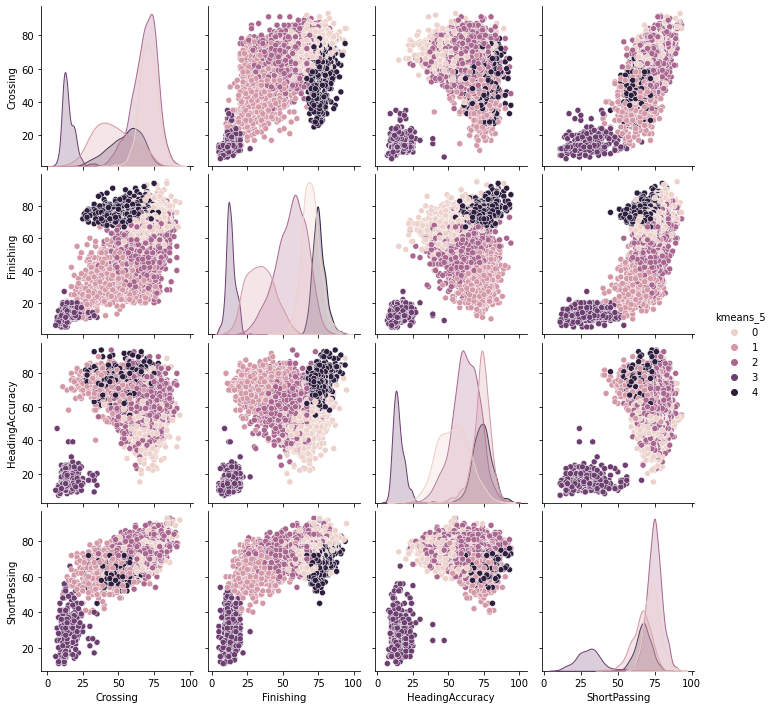

In [76]:
# Si queremos inspeccionar relaciones entre más de dos features podemos usar la clase pairplot de Seaborn
fig = plt.figure()
data = df_clusters[['Crossing', 'Finishing', 'HeadingAccuracy', 'ShortPassing','kmeans_5']]
sns.pairplot(data,
             hue = 'kmeans_5' 
             )
plt.show()

`Volleys`, `Dribbling`, `Curve`, `FKAccuracy`, `LongPassing`

<Figure size 432x288 with 0 Axes>

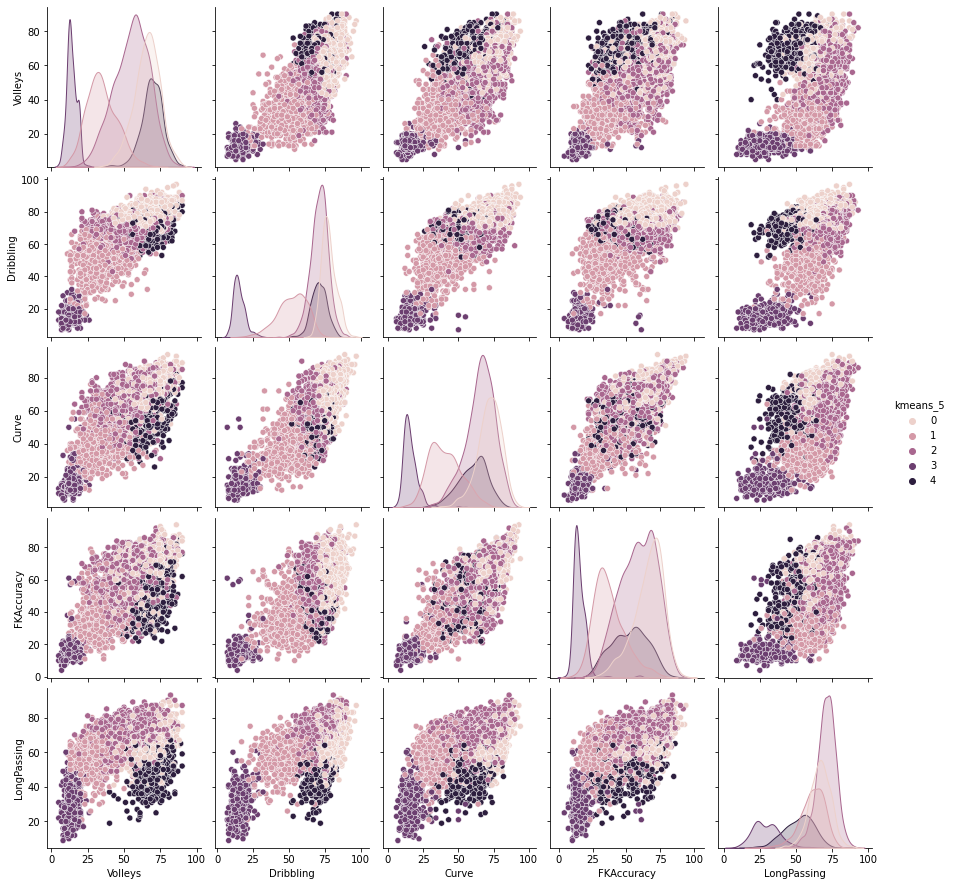

In [77]:
# Si queremos inspeccionar relaciones entre más de dos features podemos usar la clase pairplot de Seaborn
fig = plt.figure()
data = df_clusters[['Volleys', 'Dribbling', 'Curve', 'FKAccuracy', 'LongPassing','kmeans_5']]
sns.pairplot(data,
             hue = 'kmeans_5' 
             )
plt.show()

`BallControl`, `Acceleration`, `SprintSpeed`, `Agility`, `Reactions`

<Figure size 432x288 with 0 Axes>

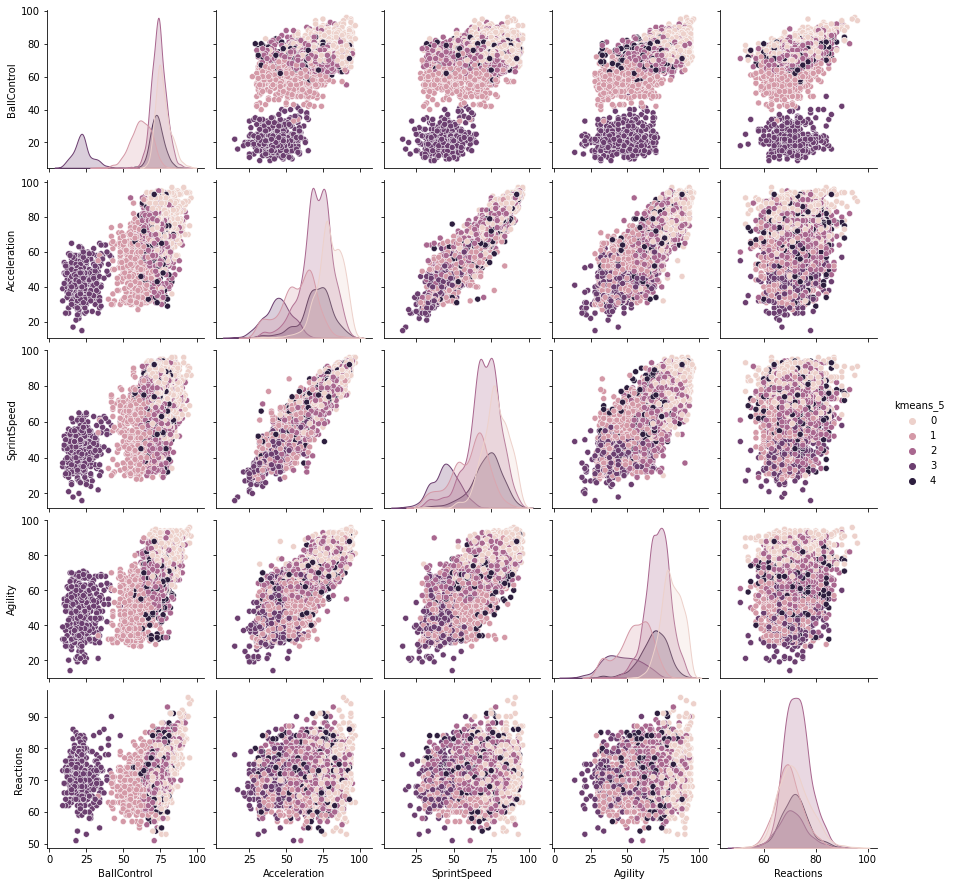

In [78]:
# Si queremos inspeccionar relaciones entre más de dos features podemos usar la clase pairplot de Seaborn
fig = plt.figure()
data = df_clusters[['BallControl', 'Acceleration', 'SprintSpeed', 'Agility', 'Reactions','kmeans_5']]
sns.pairplot(data,
             hue = 'kmeans_5' 
             )
plt.show()

`Balance`, `ShotPower`, `Jumping`, `Stamina`, `Strength`, `LongShots`

<Figure size 432x288 with 0 Axes>

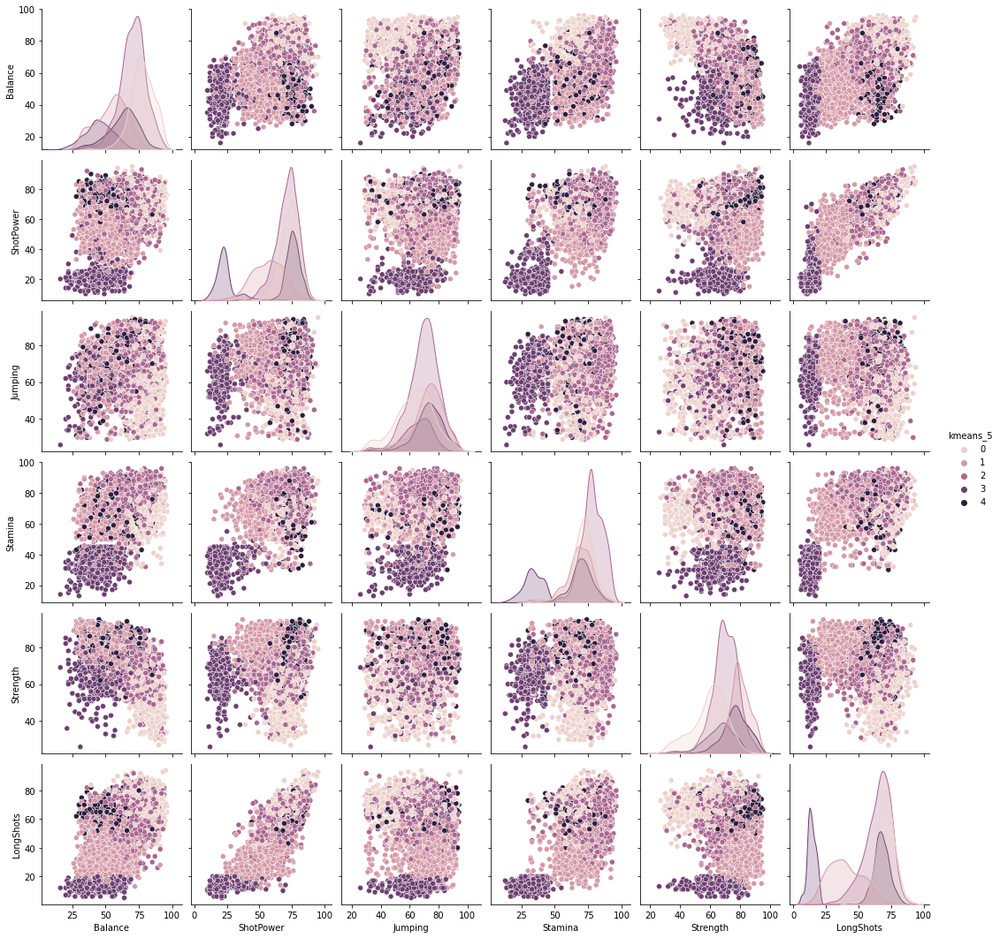

In [79]:
# Si queremos inspeccionar relaciones entre más de dos features podemos usar la clase pairplot de Seaborn
fig = plt.figure()
data = df_clusters[['Balance', 'ShotPower', 'Jumping', 'Stamina', 'Strength', 'LongShots','kmeans_5']]
sns.pairplot(data,
             hue = 'kmeans_5' 
             )
plt.show()

`Aggression`, `Interceptions`, `Positioning`, `Vision`, `Penalties`

<Figure size 432x288 with 0 Axes>

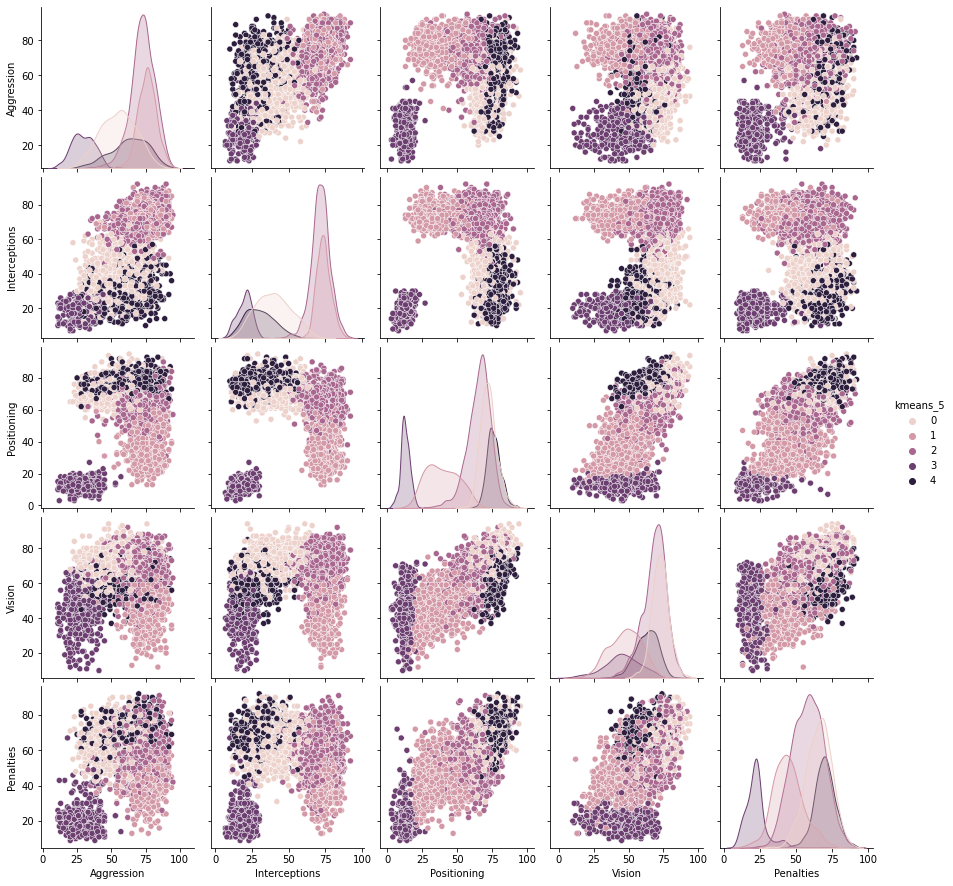

In [80]:
# Si queremos inspeccionar relaciones entre más de dos features podemos usar la clase pairplot de Seaborn
fig = plt.figure()
data = df_clusters[['Aggression', 'Interceptions', 'Positioning', 'Vision', 'Penalties','kmeans_5']]
sns.pairplot(data,
             hue = 'kmeans_5' 
             )
plt.show()

`Composure`, `Marking`, `StandingTackle`, `SlidingTackle`

<Figure size 432x288 with 0 Axes>

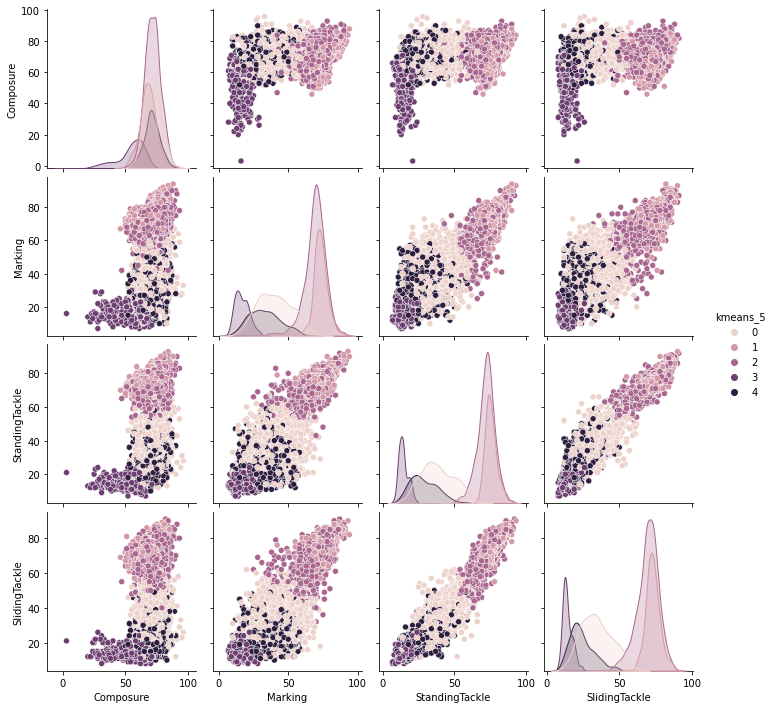

In [81]:
# Si queremos inspeccionar relaciones entre más de dos features podemos usar la clase pairplot de Seaborn
fig = plt.figure()
data = df_clusters[['Composure', 'Marking', 'StandingTackle', 'SlidingTackle','kmeans_5']]
sns.pairplot(data,
             hue = 'kmeans_5' 
             )
plt.show()

`GKDiving`, `GKHandling`, `GKKicking`, `GKPositioning`, `GKReflexes`

<Figure size 432x288 with 0 Axes>

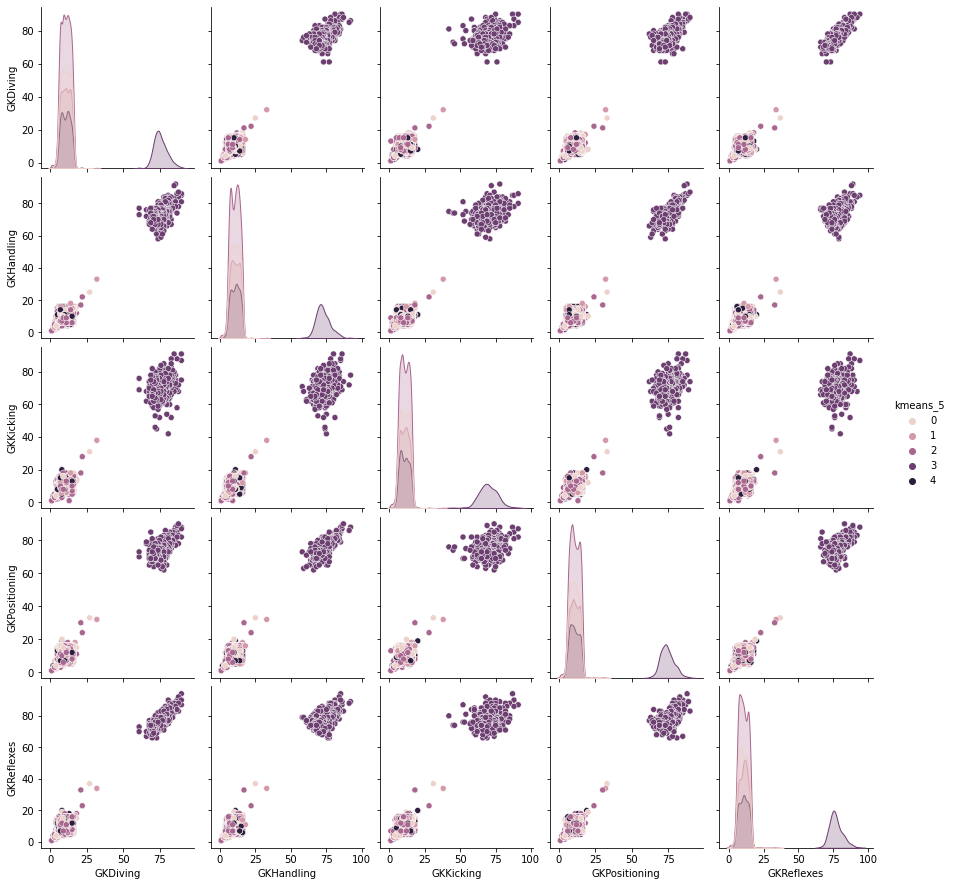

In [82]:
# Si queremos inspeccionar relaciones entre más de dos features podemos usar la clase pairplot de Seaborn
fig = plt.figure()
data = df_clusters[['GKDiving', 'GKHandling', 'GKKicking', 'GKPositioning', 'GKReflexes','kmeans_5']]
sns.pairplot(data,
             hue = 'kmeans_5' 
             )
plt.show()

Yo no le encuentro sentido a la clasificación en 5 grupos.
Voy a probar con 2 clusters

### clusters = 10

In [89]:
# En primer lugar vamos a definir un numero arbitrario de clusters
# Más adelante vamos a ver una forma de encontrar un numero adecuando de clusters
n_clust = 10

from sklearn.cluster import KMeans
# 1. instanciamos la clase Kmeans
km = KMeans(n_clusters=n_clust)

# 2. Entrenamos la clase KMeans usando los datos de la df_skills
km.fit(df_skills)


KMeans(n_clusters=10)

In [90]:
# Definimos un array de Numpy en donde guardamos las etiquetas asignadas a cada jugador
# el orden de cada etiqueta coincide con el orden en que los jugadores están en la df_skills
clusters = km.labels_
clusters

array([9, 9, 9, ..., 0, 1, 1])

In [91]:
# hacemos una copia de la df_n para trabajar sobre ella
df_clusters=df_n.copy()

# agregamos una columna y en ella ponemos el cluster al que asignado cada jugador
df_clusters['kmeans_10'] = km.labels_ #clusters

print('Kmeans encontró: ', max(km.labels_)+1, 'clusters, nosotros forzamos la cantidad')
df_clusters.sample(4)

Kmeans encontró:  10 clusters, nosotros forzamos la cantidad


,Unnamed: 0,ID,Name,Age,Photo,Nationality,Flag,Overall,Potential,Club,Club Logo,Value,Wage,Special,Preferred Foot,International Reputation,Weak Foot,Skill Moves,Work Rate,Body Type,Real Face,Position,Jersey Number,Joined,Loaned From,Contract Valid Until,Height,Weight,LS,ST,RS,LW,LF,CF,RF,RW,LAM,CAM,RAM,LM,LCM,CM,RCM,RM,LWB,LDM,CDM,RDM,RWB,LB,LCB,CB,RCB,RB,Crossing,Finishing,HeadingAccuracy,ShortPassing,Volleys,Dribbling,Curve,FKAccuracy,LongPassing,BallControl,Acceleration,SprintSpeed,Agility,Reactions,Balance,ShotPower,Jumping,Stamina,Strength,LongShots,Aggression,Interceptions,Positioning,Vision,Penalties,Composure,Marking,StandingTackle,SlidingTackle,GKDiving,GKHandling,GKKicking,GKPositioning,GKReflexes,Release Clause,kmeans_10
4405,4405,204687,P. Olkowski,28,https://cdn.sofifa.org/players/4/19/204687.png,Poland,https://cdn.sofifa.org/flags/37.png,71,71,Bolton Wanderers,https://cdn.sofifa.org/teams/2/light/4.png,€1.9M,€8K,1868,Right,1.0,2.0,3.0,Medium/ Medium,Normal,No,RB,16.0,"Jul 10, 2018",NaN,2020,6'0,168lbs,64+2,64+2,64+2,67+2,66+2,66+2,66+2,67+2,66+2,66+2,66+2,68+2,66+2,66+2,66+2,68+2,70+2,68+2,68+2,68+2,70+2,70+2,67+2,67+2,67+2,70+2,68.0,49.0,55.0,70.0,56.0,71.0,53.0,36.0,58.0,70.0,75.0,79.0,73.0,70.0,65.0,67.0,61.0,81.0,72.0,65.0,68.0,67.0,64.0,60.0,47.0,67.0,65.0,72.0,68.0,13.0,15.0,10.0,15.0,10.0,€3.6M,4
2305,2305,213620,F. Mora,24,https://cdn.sofifa.org/players/4/19/213620.png,Chile,https://cdn.sofifa.org/flags/55.png,74,78,U.N.A.M.,https://cdn.sofifa.org/teams/2/light/1881.png,€7.5M,€18K,1732,Right,1.0,3.0,3.0,Medium/ Low,Normal,No,RS,9.0,"Jul 14, 2018",NaN,2019,5'9,159lbs,73+2,73+2,73+2,68+2,71+2,71+2,71+2,68+2,69+2,69+2,69+2,67+2,62+2,62+2,62+2,67+2,47+2,47+2,47+2,47+2,47+2,45+2,41+2,41+2,41+2,45+2,32.0,77.0,71.0,66.0,66.0,72.0,55.0,40.0,64.0,72.0,84.0,78.0,75.0,67.0,69.0,75.0,81.0,71.0,71.0,69.0,39.0,21.0,75.0,57.0,68.0,68.0,22.0,23.0,18.0,12.0,11.0,11.0,11.0,9.0,€13.3M,0
3917,3917,167666,J. Carrizo,34,https://cdn.sofifa.org/players/4/19/167666.png,Argentina,https://cdn.sofifa.org/flags/52.png,72,72,Monterrey,https://cdn.sofifa.org/teams/2/light/1032.png,€1.3M,€22K,1201,Right,2.0,3.0,1.0,Medium/ Medium,Normal,No,GK,22.0,"Jul 1, 2017",NaN,2019,6'2,192lbs,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,12.0,10.0,12.0,33.0,11.0,13.0,11.0,13.0,32.0,24.0,59.0,48.0,56.0,68.0,60.0,23.0,68.0,31.0,65.0,11.0,25.0,20.0,15.0,59.0,22.0,52.0,18.0,12.0,11.0,74.0,68.0,72.0,72.0,73.0,€2.1M,2
827,827,204240,B. Reynet,27,https://cdn.sofifa.org/players/4/19/204240.png,France,https://cdn.sofifa.org/flags/18.png,78,80,Toulouse Football Club,https://cdn.sofifa.org/teams/2/light/1809.png,€8.5M,€24K,1127,Right,2.0,3.0,1.0,Medium/ Medium,Stocky,No,GK,30.0,"Jul 1, 2018",NaN,2022,6'1,187lbs,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,15.0,17.0,14.0,33.0,19.0,11.0,10.0,14.0,32.0,21.0,41.0,45.0,43.0,75.0,24.0,18.0,62.0,34.0,68.0,15.0,36.0,16.0,12.0,16.0,19.0,62.0,10.0,12.0,10.0,77.0,76.0,74.0,77.0,81.0,€17.6M,2


**Graficamos el resultado de agrupar a los jugadores usando kmedias con la cantidad de clases elegida: Visualizamos de a dos variables por vez**

In [92]:
bool_crack=df_n["Overall"] > 85
bool_no_crack=df_n["Overall"]<86

#Eligo dos números entre 0 y  de n_skills-1
skill_1=skills_ratings[9]
skill_2=skills_ratings[10]

In [93]:
kmean_clusters = go.Scatter(x=df_skills[skill_1], y=df_skills[skill_2],
                           mode='markers',
                        text=df_n.loc[:,'Name'],
                           marker=dict(
                                size=5,
                                color = clusters.astype(np.float), #set color equal to a variable
                                colorscale='Portland',
                                showscale=False)
                           )

crack =go.Scatter(x=df_skills.loc[bool_crack,skill_1], y=df_skills.loc[bool_crack,skill_2],name='Ckacks!!',
                      text=df_n.loc[bool_crack,'Name'],
                      textfont=dict(family='sans serif',size=10,color='black'),
                      opacity=0.9,mode='text')

data=[kmean_clusters,crack]

layout = go.Layout(title="Clustering K means ",titlefont=dict(size=20),
                xaxis=dict(title=skill_1),
                yaxis=dict(title=skill_2),
                autosize=False, width=1000,height=650)

fig = go.Figure(data=data, layout=layout)
fig.show()

nota: el análisis visual del resultado muestra claramente que nuestra selección inicial de forzar la formación de 5 clusters no tiene mucho sentido. Vamos a probar con 2 clusters que es lo que parece mejor.

### Features    

`Crossing`, `Finishing`, `HeadingAccuracy`, `ShortPassing`

<Figure size 432x288 with 0 Axes>

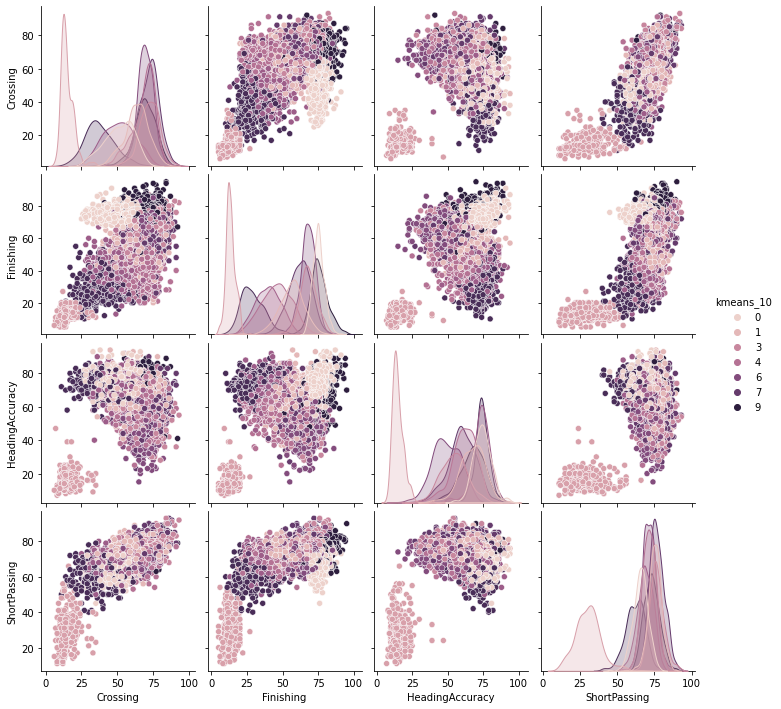

In [94]:
# Si queremos inspeccionar relaciones entre más de dos features podemos usar la clase pairplot de Seaborn
fig = plt.figure()
data = df_clusters[['Crossing', 'Finishing', 'HeadingAccuracy', 'ShortPassing','kmeans_10']]
sns.pairplot(data,
             hue = 'kmeans_10' 
             )
plt.show()

`Volleys`, `Dribbling`, `Curve`, `FKAccuracy`, `LongPassing`

<Figure size 432x288 with 0 Axes>

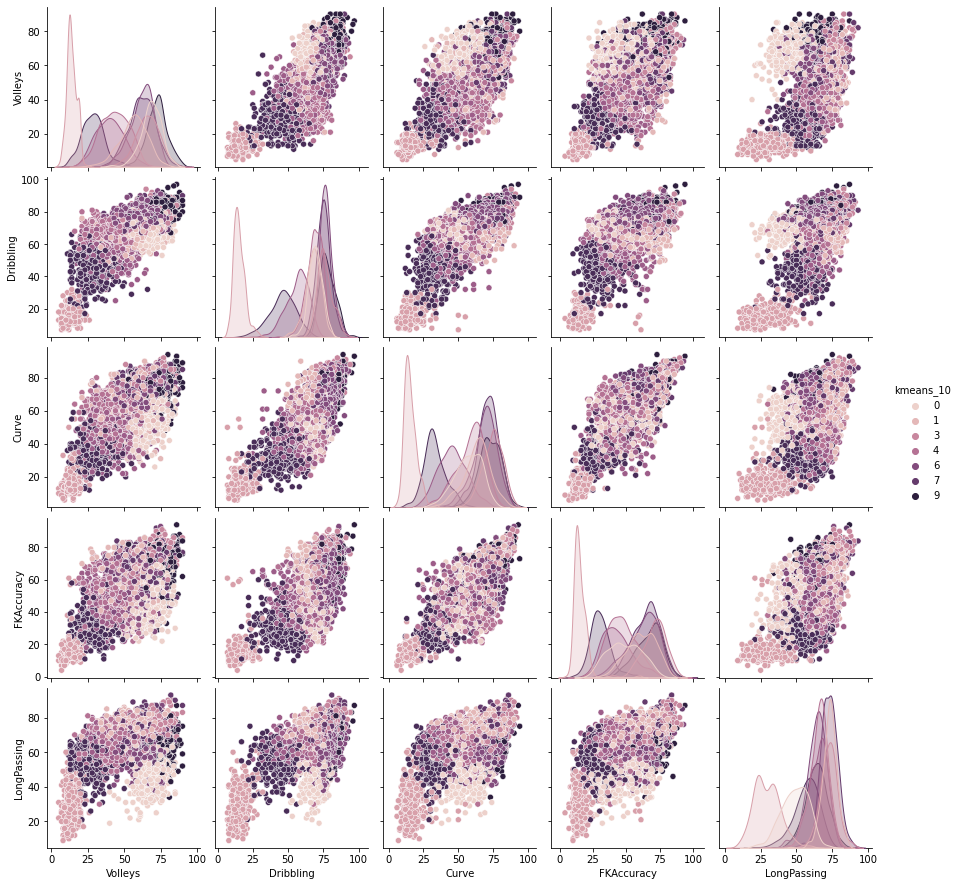

In [95]:
# Si queremos inspeccionar relaciones entre más de dos features podemos usar la clase pairplot de Seaborn
fig = plt.figure()
data = df_clusters[['Volleys', 'Dribbling', 'Curve', 'FKAccuracy', 'LongPassing','kmeans_10']]
sns.pairplot(data,
             hue = 'kmeans_10' 
             )
plt.show()

`BallControl`, `Acceleration`, `SprintSpeed`, `Agility`, `Reactions`

<Figure size 432x288 with 0 Axes>

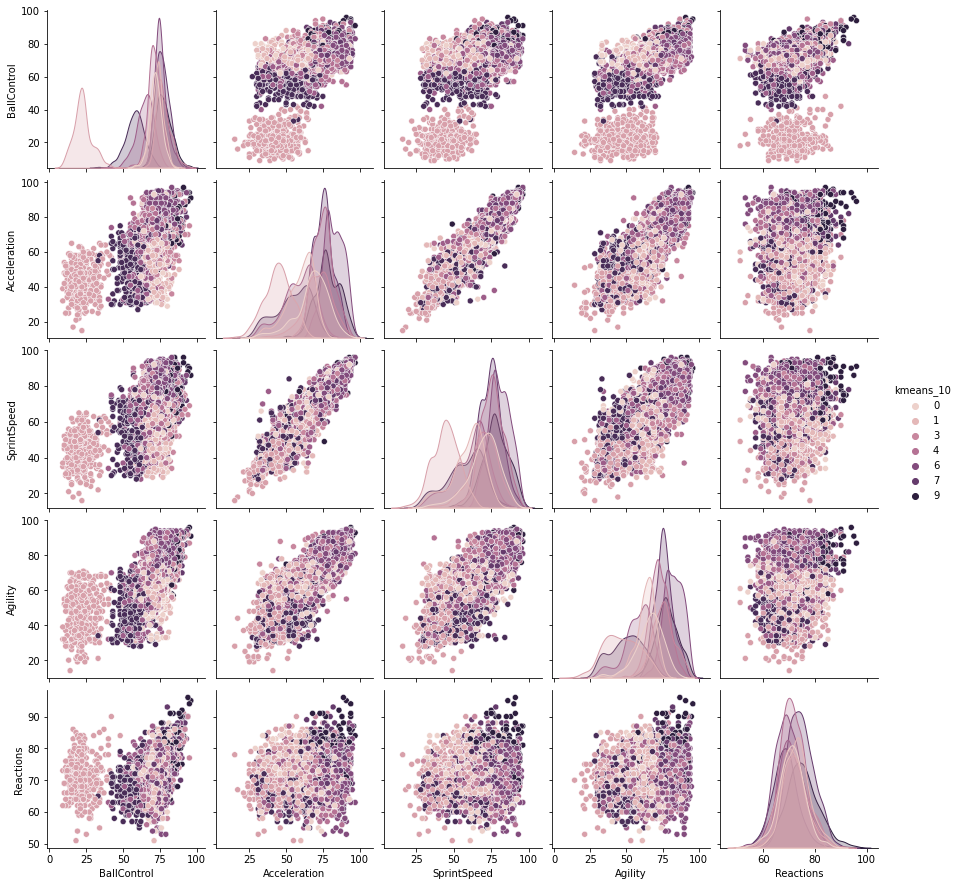

In [96]:
# Si queremos inspeccionar relaciones entre más de dos features podemos usar la clase pairplot de Seaborn
fig = plt.figure()
data = df_clusters[['BallControl', 'Acceleration', 'SprintSpeed', 'Agility', 'Reactions','kmeans_10']]
sns.pairplot(data,
             hue = 'kmeans_10' 
             )
plt.show()

`Balance`, `ShotPower`, `Jumping`, `Stamina`, `Strength`, `LongShots`

<Figure size 432x288 with 0 Axes>

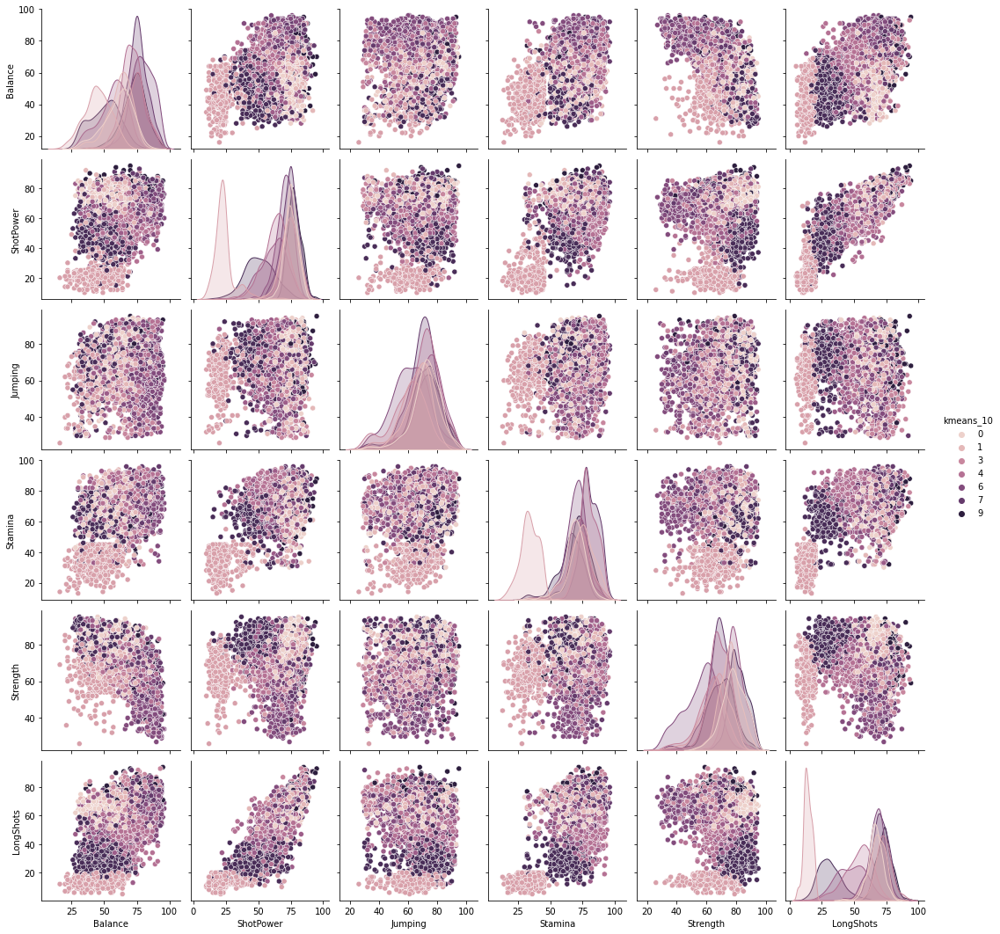

In [97]:
# Si queremos inspeccionar relaciones entre más de dos features podemos usar la clase pairplot de Seaborn
fig = plt.figure()
data = df_clusters[['Balance', 'ShotPower', 'Jumping', 'Stamina', 'Strength', 'LongShots','kmeans_10']]
sns.pairplot(data,
             hue = 'kmeans_10' 
             )
plt.show()

`Aggression`, `Interceptions`, `Positioning`, `Vision`, `Penalties`

<Figure size 432x288 with 0 Axes>

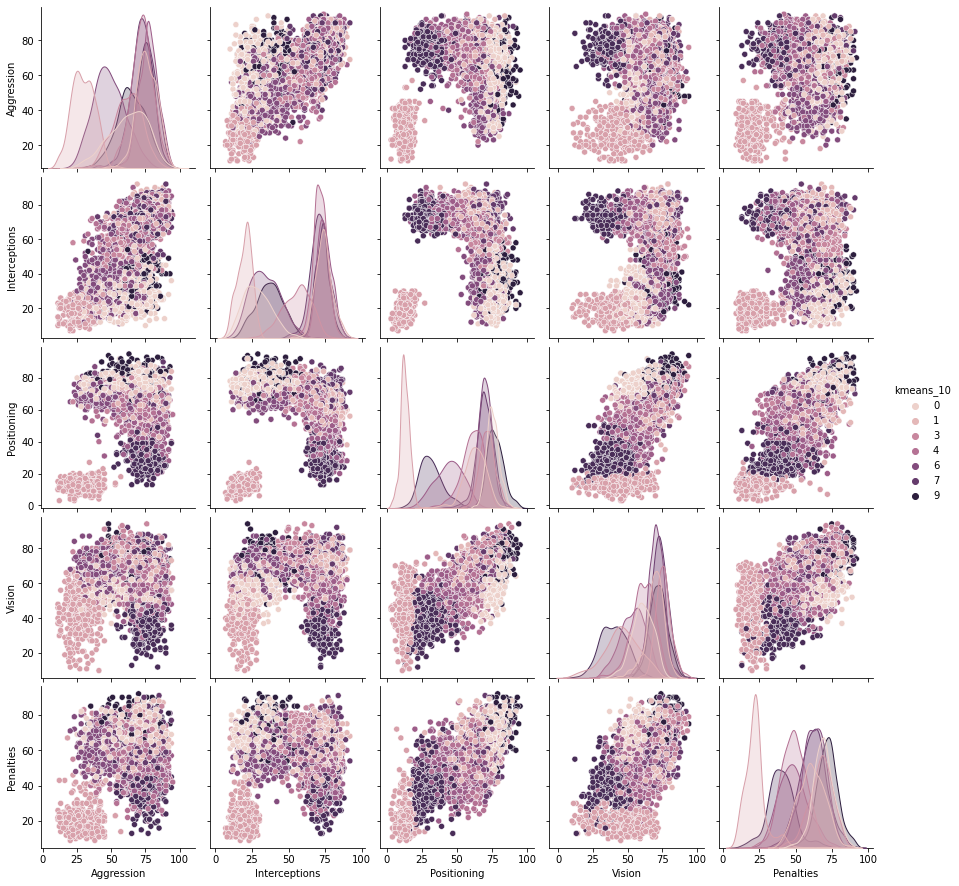

In [98]:
# Si queremos inspeccionar relaciones entre más de dos features podemos usar la clase pairplot de Seaborn
fig = plt.figure()
data = df_clusters[['Aggression', 'Interceptions', 'Positioning', 'Vision', 'Penalties','kmeans_10']]
sns.pairplot(data,
             hue = 'kmeans_10' 
             )
plt.show()

`Composure`, `Marking`, `StandingTackle`, `SlidingTackle`

<Figure size 432x288 with 0 Axes>

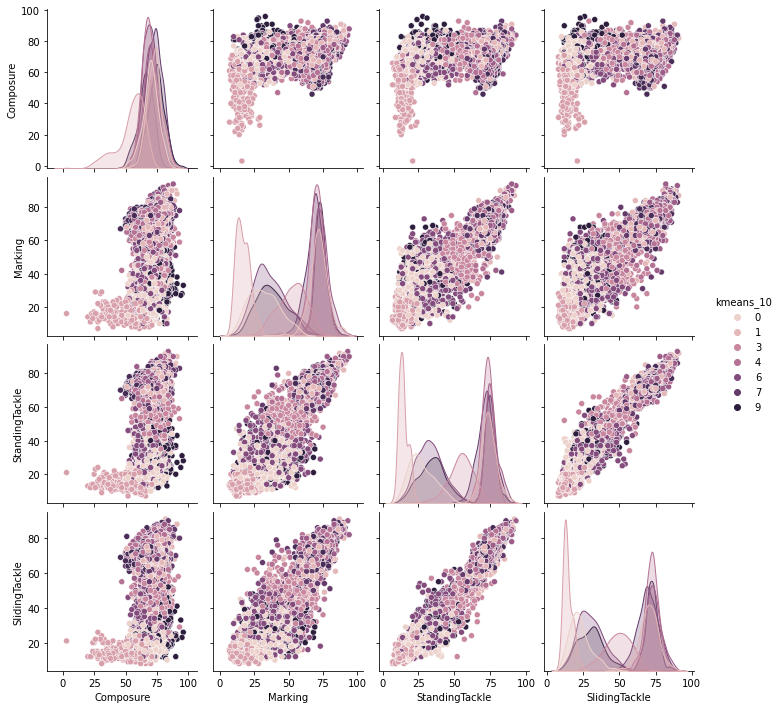

In [99]:
# Si queremos inspeccionar relaciones entre más de dos features podemos usar la clase pairplot de Seaborn
fig = plt.figure()
data = df_clusters[['Composure', 'Marking', 'StandingTackle', 'SlidingTackle','kmeans_10']]
sns.pairplot(data,
             hue = 'kmeans_10' 
             )
plt.show()

`GKDiving`, `GKHandling`, `GKKicking`, `GKPositioning`, `GKReflexes`

<Figure size 432x288 with 0 Axes>

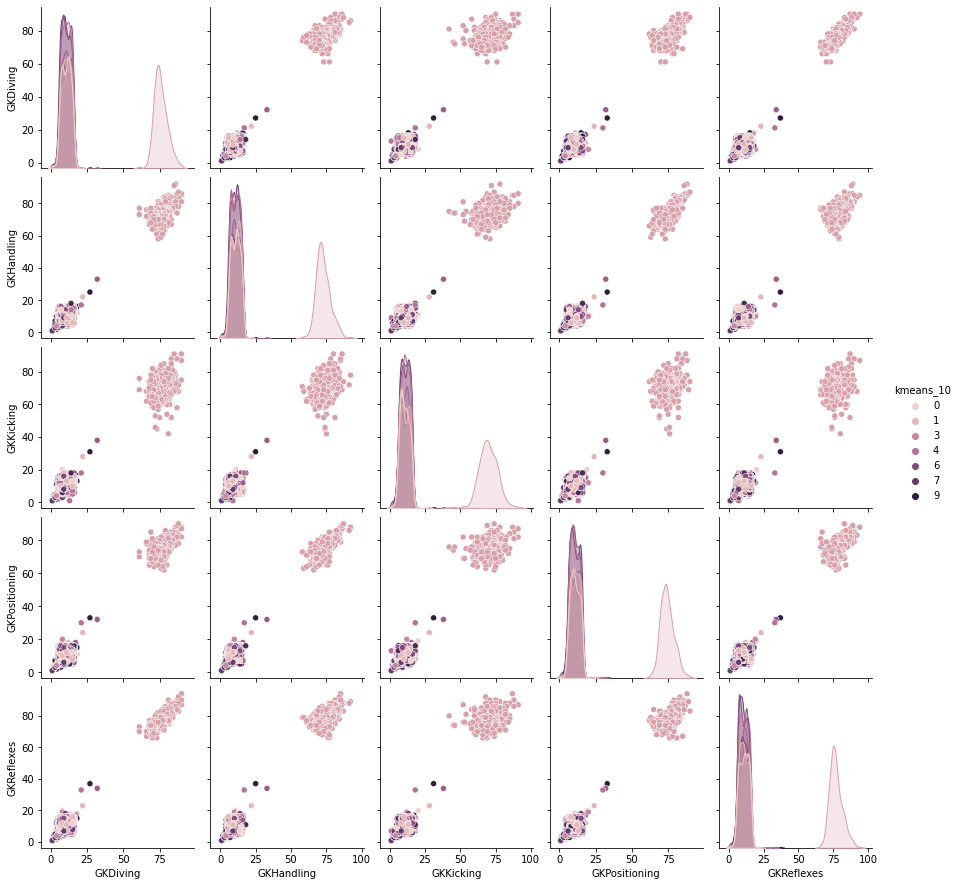

In [100]:
# Si queremos inspeccionar relaciones entre más de dos features podemos usar la clase pairplot de Seaborn
fig = plt.figure()
data = df_clusters[['GKDiving', 'GKHandling', 'GKKicking', 'GKPositioning', 'GKReflexes','kmeans_10']]
sns.pairplot(data,
             hue = 'kmeans_10' 
             )
plt.show()

### clusters = 2

In [20]:
# En primer lugar vamos a definir un numero arbitrario de clusters
# Más adelante vamos a ver una forma de encontrar un numero adecuando de clusters
n_clust = 2

from sklearn.cluster import KMeans
# 1. instanciamos la clase Kmeans
km = KMeans(n_clusters=n_clust,
            random_state=0)

# 2. Entrenamos la clase KMeans usando los datos de la df_skills
km.fit(df_skills)


KMeans(n_clusters=2, random_state=0)

In [21]:
# Definimos un array de Numpy en donde guardamos las etiquetas asignadas a cada jugador
# el orden de cada etiqueta coincide con el orden en que los jugadores están en la df_skills
clusters = km.labels_
clusters

array([0, 0, 0, ..., 0, 0, 0])

In [42]:
# hacemos una copia de la df_n para trabajar sobre ella
df_clusters=df_n.copy()

# agregamos una columna y en ella ponemos el cluster al que asignado cada jugador
df_clusters['kmeans_2'] = km.labels_ #clusters

print('Kmeans encontró: ', max(km.labels_)+1, 'clusters, nosotros forzamos la cantidad')


Kmeans encontró:  2 clusters, nosotros forzamos la cantidad


In [43]:
df_clusters.sample(4)

,Unnamed: 0,ID,Name,Age,Photo,Nationality,Flag,Overall,Potential,Club,Club Logo,Value,Wage,Special,Preferred Foot,International Reputation,Weak Foot,Skill Moves,Work Rate,Body Type,Real Face,Position,Jersey Number,Joined,Loaned From,Contract Valid Until,Height,Weight,LS,ST,RS,LW,LF,CF,RF,RW,LAM,CAM,RAM,LM,LCM,CM,RCM,RM,LWB,LDM,CDM,RDM,RWB,LB,LCB,CB,RCB,RB,Crossing,Finishing,HeadingAccuracy,ShortPassing,Volleys,Dribbling,Curve,FKAccuracy,LongPassing,BallControl,Acceleration,SprintSpeed,Agility,Reactions,Balance,ShotPower,Jumping,Stamina,Strength,LongShots,Aggression,Interceptions,Positioning,Vision,Penalties,Composure,Marking,StandingTackle,SlidingTackle,GKDiving,GKHandling,GKKicking,GKPositioning,GKReflexes,Release Clause,kmeans_2
1891,1891,215199,R. Botta,28,https://cdn.sofifa.org/players/4/19/215199.png,Argentina,https://cdn.sofifa.org/flags/52.png,75,75,San Lorenzo de Almagro,https://cdn.sofifa.org/teams/2/light/1013.png,€6.5M,€21K,1838,Left,1.0,3.0,4.0,High/ Low,Lean,No,RM,19.0,"Feb 2, 2017",NaN,2020,5'9,157lbs,68+2,68+2,68+2,74+2,72+2,72+2,72+2,74+2,74+2,74+2,74+2,73+2,68+2,68+2,68+2,73+2,56+2,54+2,54+2,54+2,56+2,52+2,43+2,43+2,43+2,52+2,73.0,68.0,38.0,71.0,65.0,78.0,76.0,74.0,68.0,75.0,78.0,78.0,81.0,68.0,73.0,75.0,52.0,72.0,67.0,77.0,55.0,33.0,69.0,79.0,64.0,77.0,33.0,27.0,26.0,8.0,9.0,13.0,8.0,7.0,€9.8M,0
4724,4724,202487,Jair,29,https://cdn.sofifa.org/players/4/19/202487.png,Brazil,https://cdn.sofifa.org/flags/54.png,71,71,Newcastle Jets,https://cdn.sofifa.org/teams/2/light/111398.png,€2.3M,€4K,1830,Left,1.0,3.0,3.0,High/ Low,Normal,No,LM,8.0,"Sep 11, 2018",NaN,2019,5'10,181lbs,69+2,69+2,69+2,70+2,70+2,70+2,70+2,70+2,69+2,69+2,69+2,69+2,65+2,65+2,65+2,69+2,58+2,55+2,55+2,55+2,58+2,55+2,49+2,49+2,49+2,55+2,67.0,73.0,63.0,65.0,65.0,71.0,65.0,69.0,62.0,70.0,77.0,73.0,81.0,70.0,68.0,67.0,61.0,76.0,68.0,64.0,50.0,63.0,74.0,64.0,65.0,65.0,22.0,35.0,24.0,10.0,14.0,14.0,13.0,7.0,€2.9M,0
2184,2184,179515,T. Mykhalyk,34,https://cdn.sofifa.org/players/4/19/179515.png,Ukraine,https://cdn.sofifa.org/flags/49.png,74,74,Lokomotiv Moscow,https://cdn.sofifa.org/teams/2/light/100765.png,€1.7M,€1K,1763,Right,2.0,3.0,2.0,Low/ High,Normal,No,CB,17.0,"Jun 18, 2013",NaN,2019,6'0,183lbs,54+2,54+2,54+2,55+2,54+2,54+2,54+2,55+2,56+2,56+2,56+2,58+2,62+2,62+2,62+2,58+2,68+2,71+2,71+2,71+2,68+2,69+2,73+2,73+2,73+2,69+2,60.0,40.0,70.0,77.0,46.0,55.0,54.0,42.0,72.0,62.0,52.0,66.0,62.0,67.0,57.0,50.0,70.0,69.0,80.0,45.0,75.0,76.0,33.0,48.0,47.0,70.0,75.0,73.0,73.0,16.0,16.0,8.0,14.0,13.0,€3.6M,0
3045,3045,212408,Frédéric Mendy,29,https://cdn.sofifa.org/players/4/19/212408.png,Guinea Bissau,https://cdn.sofifa.org/flags/119.png,73,73,Vitória de Setúbal,https://cdn.sofifa.org/teams/2/light/665.png,€4M,€7K,1728,Right,1.0,3.0,3.0,Medium/ Low,Normal,No,ST,23.0,"Jul 11, 2018",NaN,2020,6'4,181lbs,71+2,71+2,71+2,64+2,68+2,68+2,68+2,64+2,65+2,65+2,65+2,64+2,60+2,60+2,60+2,64+2,48+2,49+2,49+2,49+2,48+2,46+2,48+2,48+2,48+2,46+2,42.0,75.0,80.0,65.0,71.0,65.0,53.0,48.0,43.0,64.0,67.0,63.0,53.0,71.0,66.0,76.0,72.0,80.0,85.0,55.0,79.0,25.0,74.0,67.0,67.0,70.0,29.0,26.0,20.0,10.0,7.0,10.0,10.0,10.0,€8.4M,0


**Graficamos el resultado de agrupar a los jugadores usando kmedias con la cantidad de clases elegida: Visualizamos de a dos variables por vez**

In [44]:
bool_crack=df_n["Overall"] > 85
bool_no_crack=df_n["Overall"]<86

#Elijo dos números entre 0 y  de n_skills-1
skill_1=skills_ratings[9]
skill_2=skills_ratings[10]

In [45]:
kmean_clusters = go.Scatter(x=df_skills[skill_1], y=df_skills[skill_2],
                           mode='markers',
                        text=df_n.loc[:,'Name'],
                           marker=dict(
                                size=5,
                                color = clusters.astype(np.float), #set color equal to a variable
                                colorscale='Portland',
                                showscale=False)
                           )

crack =go.Scatter(x=df_skills.loc[bool_crack,skill_1], y=df_skills.loc[bool_crack,skill_2],name='Ckacks!!',
                      text=df_n.loc[bool_crack,'Name'],
                      textfont=dict(family='sans serif',size=10,color='black'),
                      opacity=0.9,mode='text')

data=[kmean_clusters,crack]

layout = go.Layout(title="Clustering K means ",titlefont=dict(size=20),
                xaxis=dict(title=skill_1),
                yaxis=dict(title=skill_2),
                autosize=False, width=1000,height=650)

fig = go.Figure(data=data, layout=layout)
fig.show()

### Features    

`Crossing`, `Finishing`, `HeadingAccuracy`, `ShortPassing`

<Figure size 432x288 with 0 Axes>

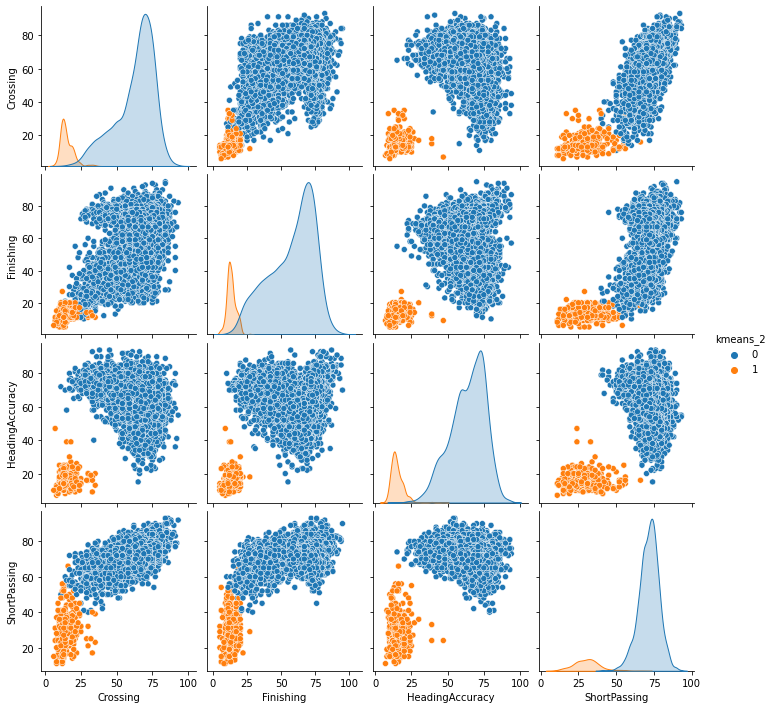

In [48]:
# Si queremos inspeccionar relaciones entre más de dos features podemos usar la clase pairplot de Seaborn
fig = plt.figure()
data = df_clusters[['Crossing', 'Finishing', 'HeadingAccuracy', 'ShortPassing','kmeans_2']]
sns.pairplot(data,
             hue = 'kmeans_2' 
             )
plt.show()

`Volleys`, `Dribbling`, `Curve`, `FKAccuracy`, `LongPassing`

<Figure size 432x288 with 0 Axes>

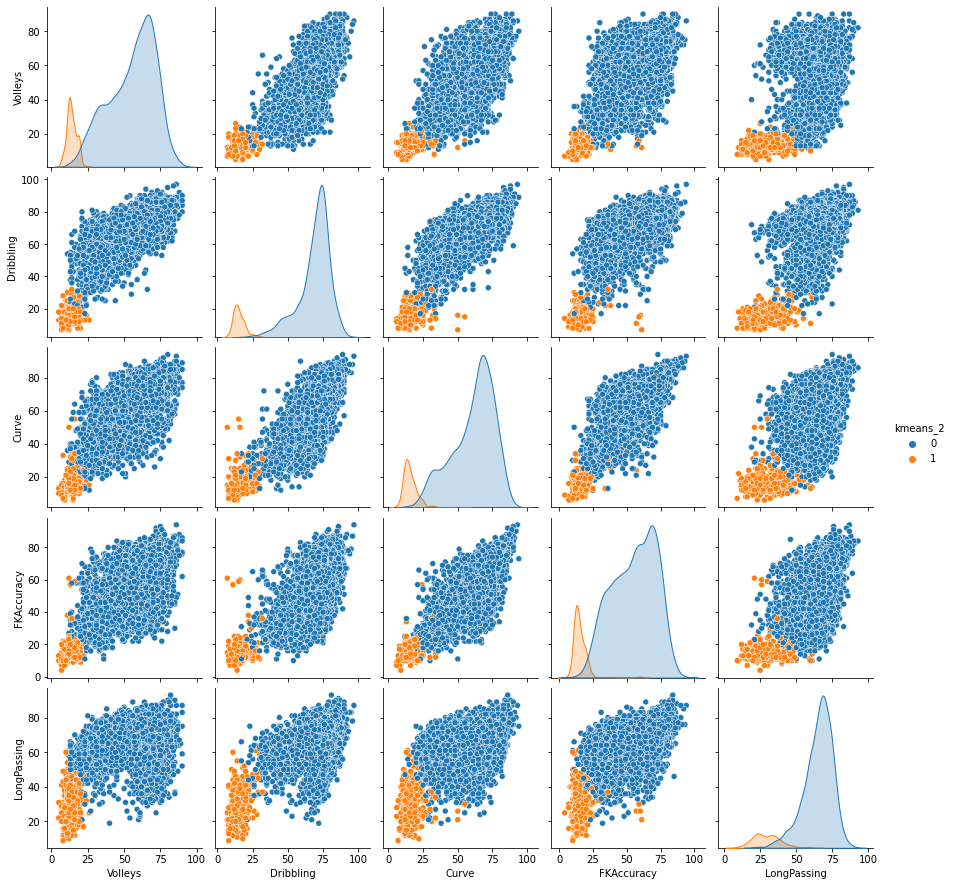

In [49]:
# Si queremos inspeccionar relaciones entre más de dos features podemos usar la clase pairplot de Seaborn
fig = plt.figure()
data = df_clusters[['Volleys', 'Dribbling', 'Curve', 'FKAccuracy', 'LongPassing','kmeans_2']]
sns.pairplot(data,
             hue = 'kmeans_2' 
             )
plt.show()

`BallControl`, `Acceleration`, `SprintSpeed`, `Agility`, `Reactions`

<Figure size 432x288 with 0 Axes>

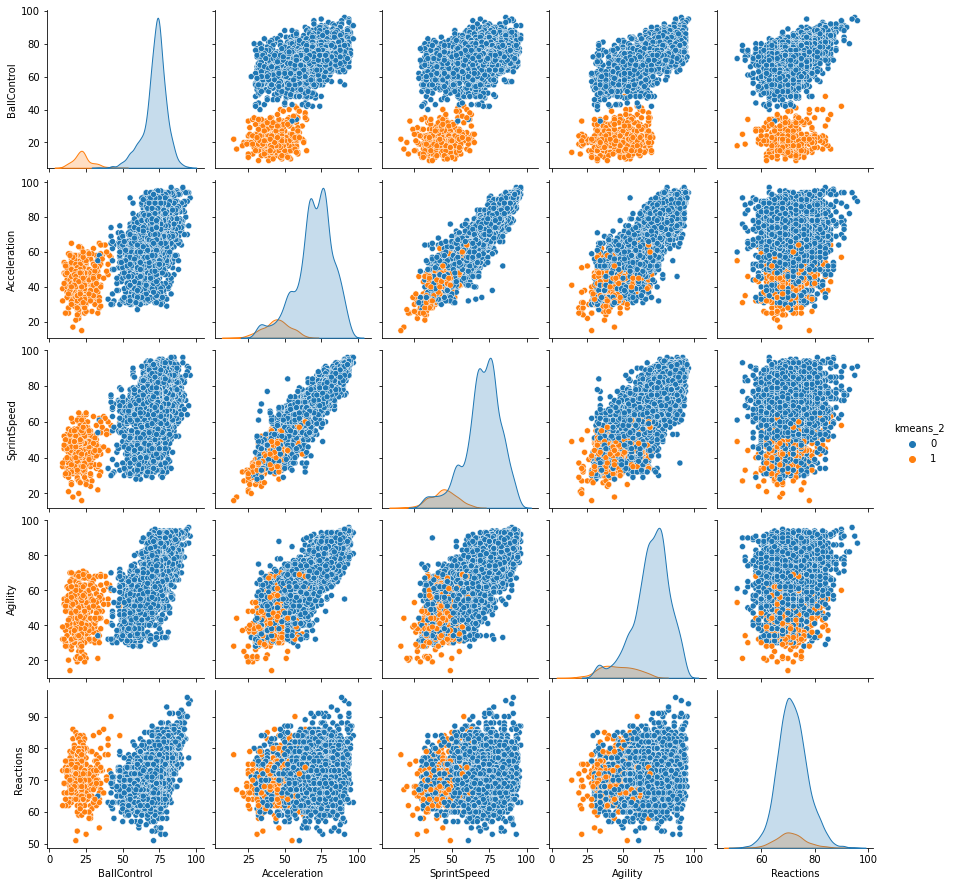

In [50]:
# Si queremos inspeccionar relaciones entre más de dos features podemos usar la clase pairplot de Seaborn
fig = plt.figure()
data = df_clusters[['BallControl', 'Acceleration', 'SprintSpeed', 'Agility', 'Reactions','kmeans_2']]
sns.pairplot(data,
             hue = 'kmeans_2' 
             )
plt.show()

`Balance`, `ShotPower`, `Jumping`, `Stamina`, `Strength`, `LongShots`

<Figure size 432x288 with 0 Axes>

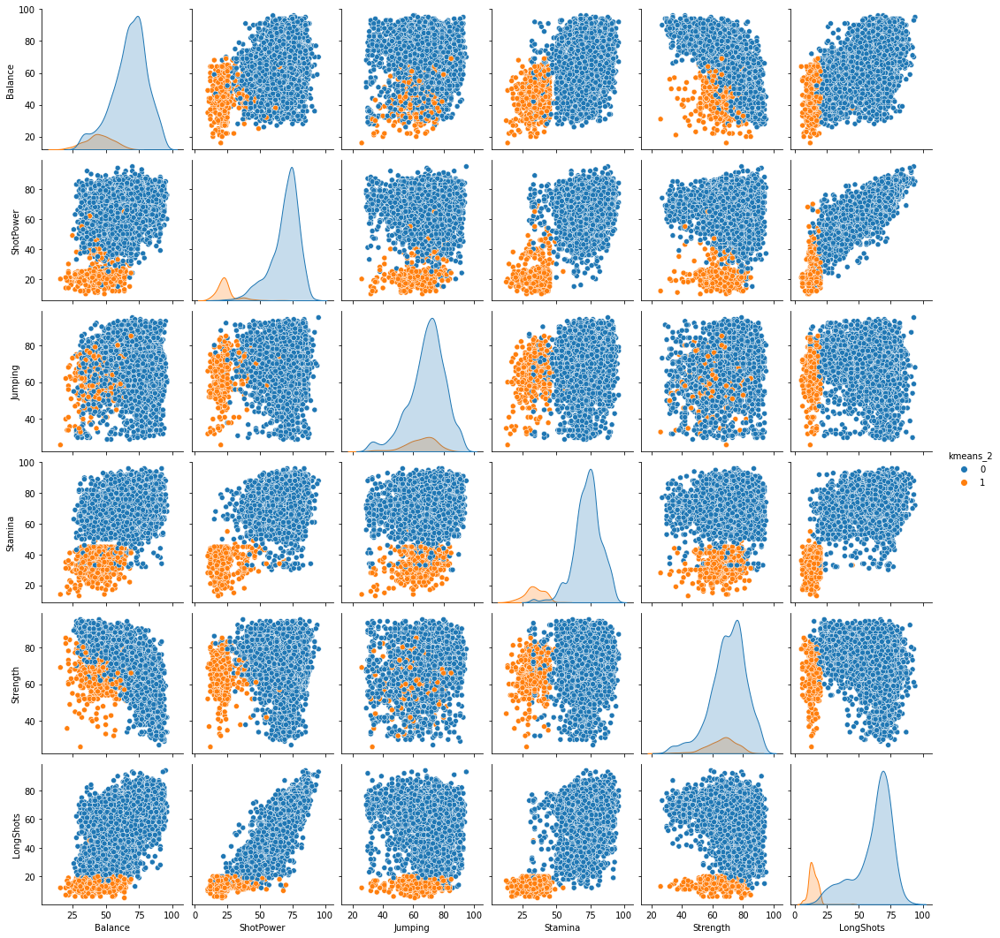

In [51]:
# Si queremos inspeccionar relaciones entre más de dos features podemos usar la clase pairplot de Seaborn
fig = plt.figure()
data = df_clusters[['Balance', 'ShotPower', 'Jumping', 'Stamina', 'Strength', 'LongShots','kmeans_2']]
sns.pairplot(data,
             hue = 'kmeans_2' 
             )
plt.show()

`Aggression`, `Interceptions`, `Positioning`, `Vision`, `Penalties`

<Figure size 432x288 with 0 Axes>

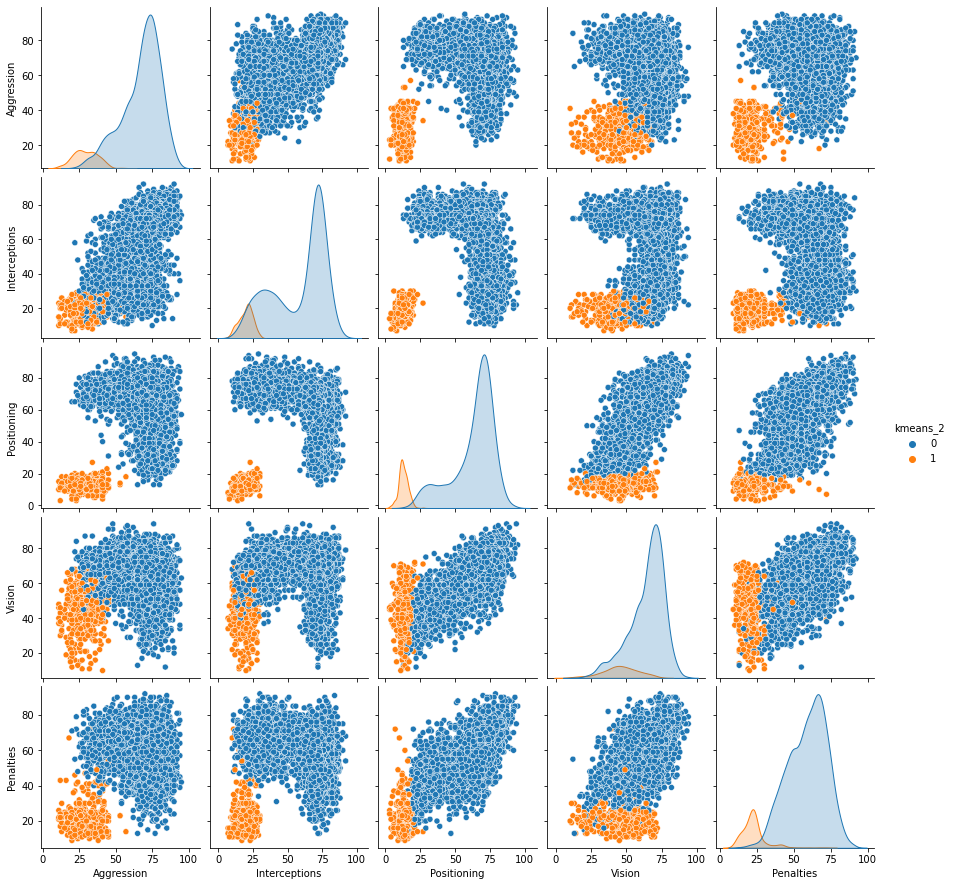

In [52]:
# Si queremos inspeccionar relaciones entre más de dos features podemos usar la clase pairplot de Seaborn
fig = plt.figure()
data = df_clusters[['Aggression', 'Interceptions', 'Positioning', 'Vision', 'Penalties','kmeans_2']]
sns.pairplot(data,
             hue = 'kmeans_2' 
             )
plt.show()

`Composure`, `Marking`, `StandingTackle`, `SlidingTackle`

<Figure size 432x288 with 0 Axes>

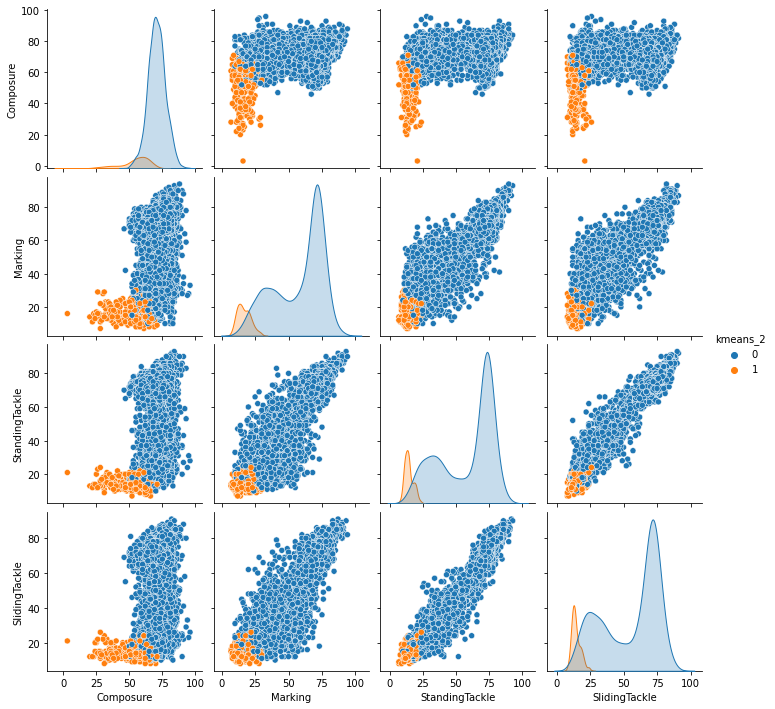

In [53]:
# Si queremos inspeccionar relaciones entre más de dos features podemos usar la clase pairplot de Seaborn
fig = plt.figure()
data = df_clusters[['Composure', 'Marking', 'StandingTackle', 'SlidingTackle','kmeans_2']]
sns.pairplot(data,
             hue = 'kmeans_2' 
             )
plt.show()

`GKDiving`, `GKHandling`, `GKKicking`, `GKPositioning`, `GKReflexes`

<Figure size 432x288 with 0 Axes>

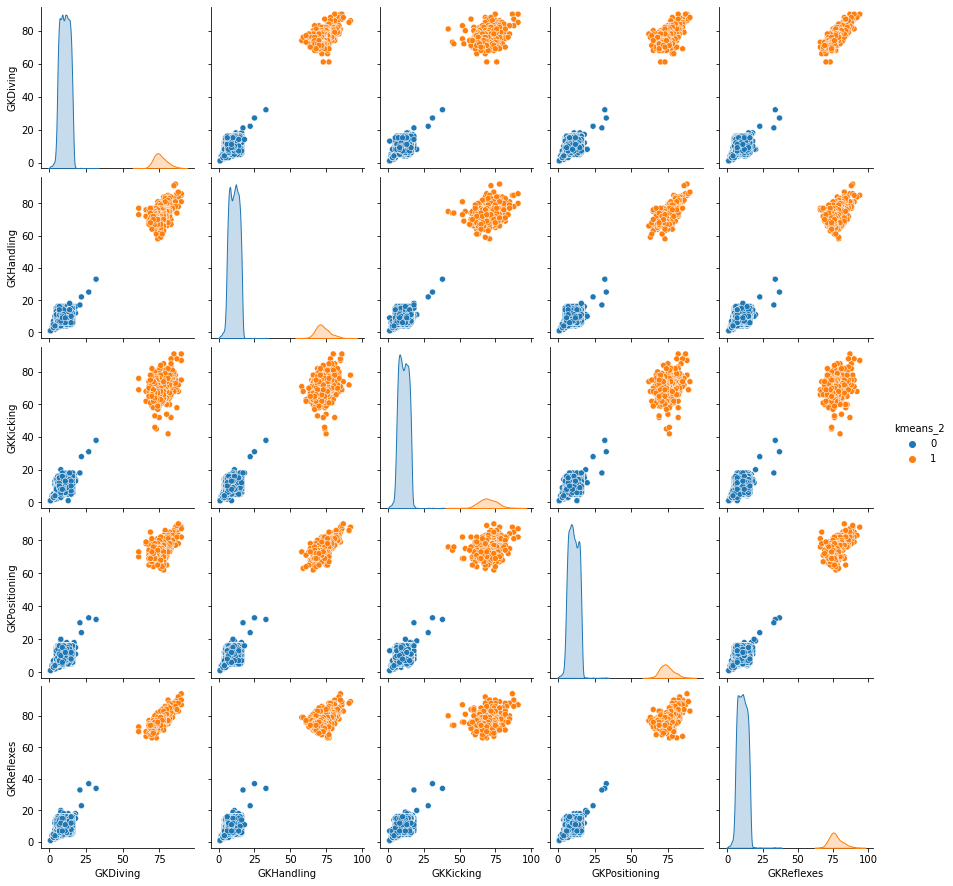

In [54]:
# Si queremos inspeccionar relaciones entre más de dos features podemos usar la clase pairplot de Seaborn
fig = plt.figure()
data = df_clusters[['GKDiving', 'GKHandling', 'GKKicking', 'GKPositioning', 'GKReflexes','kmeans_2']]
sns.pairplot(data,
             hue = 'kmeans_2' 
             )
plt.show()

In [56]:
# Cuantas fetures usamos par entrenar al modelo de KM?
km.n_features_in_

34

In [57]:
# Qué Features se usaron para entrenar el modelo de KM?
km.feature_names_in_

array(['Crossing', 'Finishing', 'HeadingAccuracy', 'ShortPassing',
       'Volleys', 'Dribbling', 'Curve', 'FKAccuracy', 'LongPassing',
       'BallControl', 'Acceleration', 'SprintSpeed', 'Agility',
       'Reactions', 'Balance', 'ShotPower', 'Jumping', 'Stamina',
       'Strength', 'LongShots', 'Aggression', 'Interceptions',
       'Positioning', 'Vision', 'Penalties', 'Composure', 'Marking',
       'StandingTackle', 'SlidingTackle', 'GKDiving', 'GKHandling',
       'GKKicking', 'GKPositioning', 'GKReflexes'], dtype=object)

Vamos a crear una nueva varible que clasifique a los jugadores de acuerdo a su posición en el campo de juego

In [59]:
forwards=['RF', 'ST', 'LW', 'LF', 'RS', 'LS', 'RM', 'LM','RW']
midfielders=['RCM','LCM','LDM','CAM','CDM','LAM','RDM','CM','RAM','CF']
defenders=['RCB','CB','LCB','LB','RB','RWB','LWB']
goalkeepers=['GK']

def pos2(position):
    if position in forwards:
        return 'Forward'
    
    elif position in midfielders:
        return 'Midfielder'
    
    elif position in defenders:
        return 'Defender'
    
    elif position in goalkeepers:
        return 'GK'
    
    else:
        return 'nan'

In [60]:
df_n["Position2"]=df_n["Position"].apply(lambda x: pos2(x)) #notar que para esto tb se podría usar la funcion assign

df_n["Position2"].value_counts()

Forward       1488
Defender      1485
Midfielder    1341
GK             435
Name: Position2, dtype: int64

## Elbow method
Uno de los hiperparámetros más importantes de la clasificación Kmeans es el número de clusters.
Si bien en algunos casos esa elección puede ser sencilla, hay métodos que permiten determinar cuál sería un buen número de clusteres para un dataset determinado



Text(0.5, 1.0, 'Inertia of k-Means versus number of clusters')

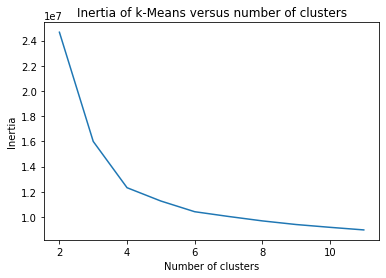

In [61]:
scores = [KMeans(n_clusters=i).fit(df_skills).inertia_ for i in range(2,12)]

plt.plot(np.arange(2, 12), scores)
plt.xlabel('Number of clusters')
plt.ylabel("Inertia")
plt.title("Inertia of k-Means versus number of clusters")

Según el criterio del codo el mejor numero de clusters sería 4.

## Clustering con Kmeans sin arqueros
En las visualizaciones anteriores hemos visto que los arqueros agrupan siempre diferente que el resto de los jugadores. Por lo tanto para el siguiente análisis lo que vamos a hacer es sacar a los arqueros de este análisis

In [7]:
n=10000
df_n=df.loc[:n]
df_n=df_n[(df_n["Position"]!='GK')&(df_n['Overall']>70)]

skills_ratings = ['Crossing', 'Finishing', 'HeadingAccuracy', 'ShortPassing',
                  'Volleys','Dribbling', 'Curve', 'FKAccuracy', 'LongPassing',
                  'BallControl', 'Acceleration', 'SprintSpeed', 'Agility', 'Reactions',
                  'Balance', 'ShotPower', 'Jumping','Stamina', 'Strength', 'LongShots',
                  'Aggression', 'Interceptions', 'Positioning','Vision', 'Penalties',
                  'Composure', 'Marking', 'StandingTackle', 'SlidingTackle']

df_skills=df_n[skills_ratings]

Text(0.5, 1.0, 'Inertia of k-Means versus number of clusters')

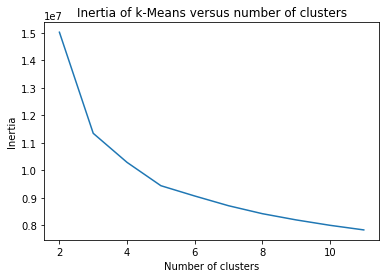

In [8]:
scores = [KMeans(n_clusters=i).fit(df_skills).inertia_ for i in range(2,12)]

plt.plot(np.arange(2, 12), scores)
plt.xlabel('Number of clusters')
plt.ylabel("Inertia")
plt.title("Inertia of k-Means versus number of clusters")

Si sacamos a los arquero, mirando el grafico del codo me parece que el mejor numero de clusters va a ser 3

In [9]:
# En primer lugar vamos a definir un numero arbitrario de clusters
# Más adelante vamos a ver una forma de encontrar un numero adecuando de clusters
n_clust = 3

from sklearn.cluster import KMeans
# 1. instanciamos la clase Kmeans
km = KMeans(n_clusters=n_clust)

# 2. Entrenamos la clase KMeans usando los datos de la df_skills
km.fit(df_skills)


KMeans(n_clusters=3)

In [10]:
# hacemos una copia de la df_n para trabajar sobre ella
df_clusters=df_n.copy()

# agregamos una columna y en ella ponemos el cluster al que asignado cada jugador
df_clusters['kmeans_3'] = km.labels_ #clusters

print('Kmeans encontró: ', max(km.labels_)+1, 'clusters, nosotros forzamos la cantidad')
df_clusters.sample(4)

Kmeans encontró:  3 clusters, nosotros forzamos la cantidad


,Unnamed: 0,ID,Name,Age,Photo,Nationality,Flag,Overall,Potential,Club,Club Logo,Value,Wage,Special,Preferred Foot,International Reputation,Weak Foot,Skill Moves,Work Rate,Body Type,Real Face,Position,Jersey Number,Joined,Loaned From,Contract Valid Until,Height,Weight,LS,ST,RS,LW,LF,CF,RF,RW,LAM,CAM,RAM,LM,LCM,CM,RCM,RM,LWB,LDM,CDM,RDM,RWB,LB,LCB,CB,RCB,RB,Crossing,Finishing,HeadingAccuracy,ShortPassing,Volleys,Dribbling,Curve,FKAccuracy,LongPassing,BallControl,Acceleration,SprintSpeed,Agility,Reactions,Balance,ShotPower,Jumping,Stamina,Strength,LongShots,Aggression,Interceptions,Positioning,Vision,Penalties,Composure,Marking,StandingTackle,SlidingTackle,GKDiving,GKHandling,GKKicking,GKPositioning,GKReflexes,Release Clause,kmeans_3
3618,3618,239744,M. Cuisance,18,https://cdn.sofifa.org/players/4/19/239744.png,France,https://cdn.sofifa.org/flags/18.png,72,85,Borussia Mönchengladbach,https://cdn.sofifa.org/teams/2/light/23.png,€5.5M,€9K,1928,Left,1.0,3.0,4.0,Medium/ Medium,Normal,No,CM,27.0,"Jul 1, 2017",NaN,2023,5'11,161lbs,65+2,65+2,65+2,72+2,70+2,70+2,70+2,72+2,72+2,72+2,72+2,72+2,70+2,70+2,70+2,72+2,64+2,62+2,62+2,62+2,64+2,62+2,55+2,55+2,55+2,62+2,79.0,59.0,49.0,78.0,63.0,75.0,85.0,75.0,73.0,74.0,79.0,66.0,84.0,66.0,74.0,78.0,59.0,64.0,47.0,78.0,57.0,48.0,61.0,76.0,61.0,62.0,49.0,59.0,55.0,9.0,14.0,11.0,8.0,15.0,€12.8M,1
4334,4334,204406,G. Achilier,33,https://cdn.sofifa.org/players/4/19/204406.png,Ecuador,https://cdn.sofifa.org/flags/57.png,71,71,Monarcas Morelia,https://cdn.sofifa.org/teams/2/light/1028.png,€950K,€7K,1424,Right,1.0,2.0,2.0,Medium/ Medium,Normal,No,LCB,24.0,"Jan 1, 2017",NaN,2022,5'10,187lbs,40+2,40+2,40+2,42+2,40+2,40+2,40+2,42+2,41+2,41+2,41+2,45+2,47+2,47+2,47+2,45+2,61+2,61+2,61+2,61+2,61+2,63+2,70+2,70+2,70+2,63+2,49.0,18.0,71.0,51.0,21.0,43.0,36.0,30.0,37.0,53.0,55.0,42.0,36.0,65.0,47.0,16.0,76.0,68.0,82.0,17.0,68.0,74.0,28.0,32.0,35.0,54.0,70.0,74.0,70.0,15.0,8.0,13.0,15.0,9.0,€1.6M,2
4033,4033,164633,T. Hoogland,33,https://cdn.sofifa.org/players/4/19/164633.png,Germany,https://cdn.sofifa.org/flags/21.png,71,71,VfL Bochum 1848,https://cdn.sofifa.org/teams/2/light/160.png,€950K,€11K,1834,Right,1.0,2.0,2.0,Medium/ Medium,Normal,No,LCB,2.0,"Jul 1, 2015",NaN,2019,6'0,176lbs,63+2,63+2,63+2,60+2,60+2,60+2,60+2,60+2,59+2,59+2,59+2,60+2,61+2,61+2,61+2,60+2,64+2,65+2,65+2,65+2,64+2,65+2,69+2,69+2,69+2,65+2,66.0,57.0,72.0,64.0,61.0,61.0,60.0,52.0,62.0,64.0,52.0,51.0,53.0,67.0,63.0,72.0,80.0,62.0,75.0,62.0,72.0,68.0,64.0,45.0,61.0,72.0,63.0,73.0,72.0,13.0,12.0,11.0,16.0,8.0,€1.5M,0
233,233,227055,Gelson Martins,23,https://cdn.sofifa.org/players/4/19/227055.png,Portugal,https://cdn.sofifa.org/flags/38.png,82,87,Atlético Madrid,https://cdn.sofifa.org/teams/2/light/240.png,€29.5M,€59K,2023,Right,3.0,3.0,5.0,High/ Medium,Lean,No,RM,18.0,"Jul 25, 2018",NaN,2023,5'8,159lbs,74+3,74+3,74+3,81+3,79+3,79+3,79+3,81+3,79+3,79+3,79+3,81+3,73+3,73+3,73+3,81+3,68+3,62+3,62+3,62+3,68+3,65+3,53+3,53+3,53+3,65+3,81.0,66.0,51.0,78.0,74.0,85.0,82.0,60.0,55.0,83.0,95.0,94.0,94.0,83.0,92.0,72.0,65.0,87.0,48.0,69.0,60.0,43.0,82.0,79.0,66.0,85.0,54.0,46.0,36.0,12.0,9.0,7.0,6.0,9.0,€62.7M,1


### Features    

`Crossing`, `Finishing`, `HeadingAccuracy`, `ShortPassing`

<Figure size 432x288 with 0 Axes>

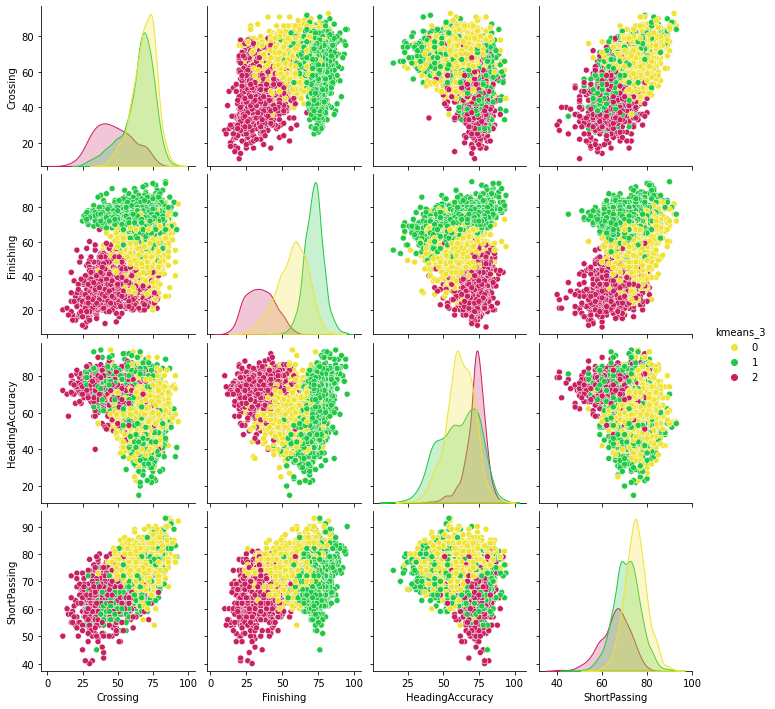

In [12]:
# Si queremos inspeccionar relaciones entre más de dos features podemos usar la clase pairplot de Seaborn
fig = plt.figure()
data = df_clusters[['Crossing', 'Finishing', 'HeadingAccuracy', 'ShortPassing','kmeans_3']]
sns.pairplot(data,
             hue = 'kmeans_3',
             palette={0:'#f0e330', #yellow
                      1:'#20c945', #green
                      2:'#c92061'} #pink 
             )
plt.show()

`Volleys`, `Dribbling`, `Curve`, `FKAccuracy`, `LongPassing`

<Figure size 432x288 with 0 Axes>

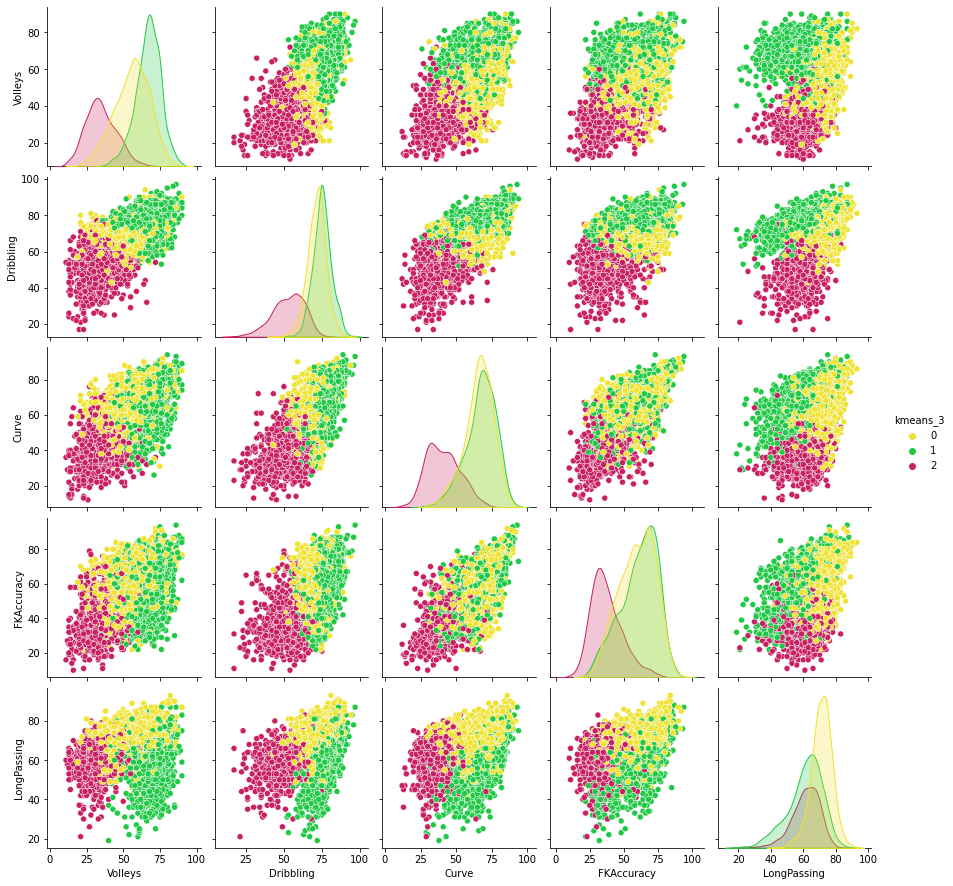

In [13]:
# Si queremos inspeccionar relaciones entre más de dos features podemos usar la clase pairplot de Seaborn
fig = plt.figure()
data = df_clusters[['Volleys', 'Dribbling', 'Curve', 'FKAccuracy', 'LongPassing','kmeans_3']]
sns.pairplot(data,
             hue = 'kmeans_3',
             palette={0:'#f0e330', #yellow
                      1:'#20c945', #green
                      2:'#c92061'} #pink 
             )
plt.show()

`BallControl`, `Acceleration`, `SprintSpeed`, `Agility`, `Reactions`

<Figure size 432x288 with 0 Axes>

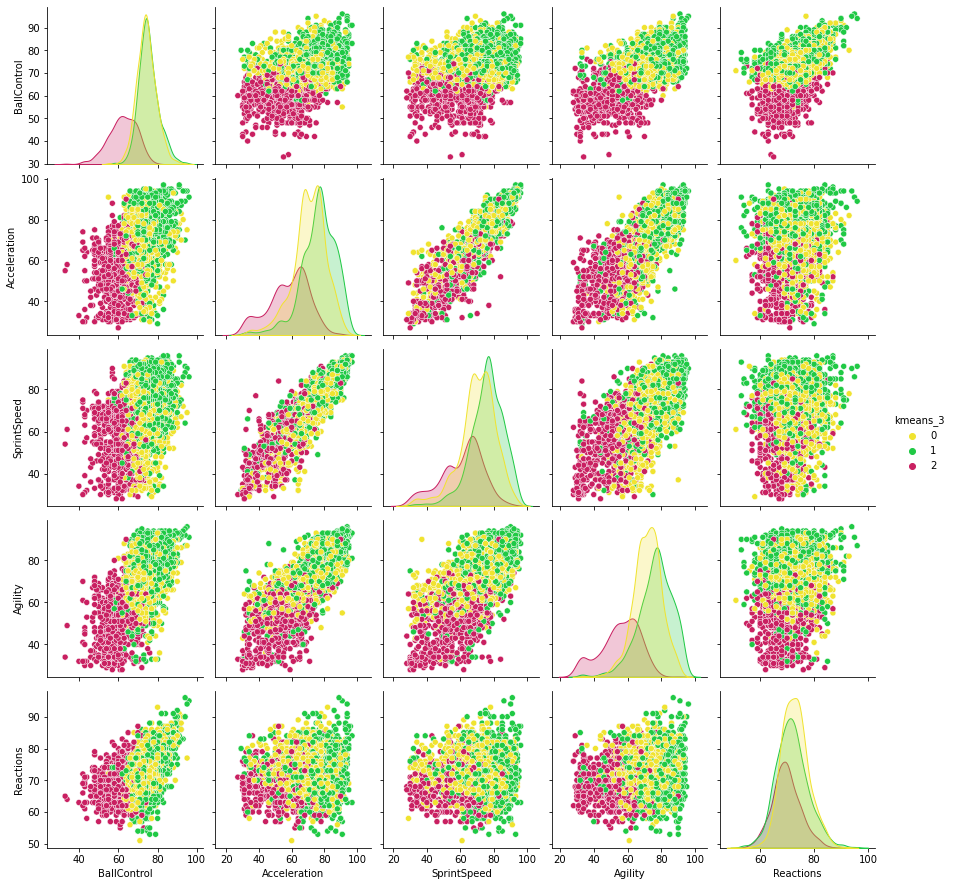

In [14]:
# Si queremos inspeccionar relaciones entre más de dos features podemos usar la clase pairplot de Seaborn
fig = plt.figure()
data = df_clusters[['BallControl', 'Acceleration', 'SprintSpeed', 'Agility', 'Reactions','kmeans_3']]
sns.pairplot(data,
             hue = 'kmeans_3',
             palette={0:'#f0e330', #yellow
                      1:'#20c945', #green
                      2:'#c92061'} #pink 
             )
plt.show()

`Balance`, `ShotPower`, `Jumping`, `Stamina`, `Strength`, `LongShots`

<Figure size 432x288 with 0 Axes>

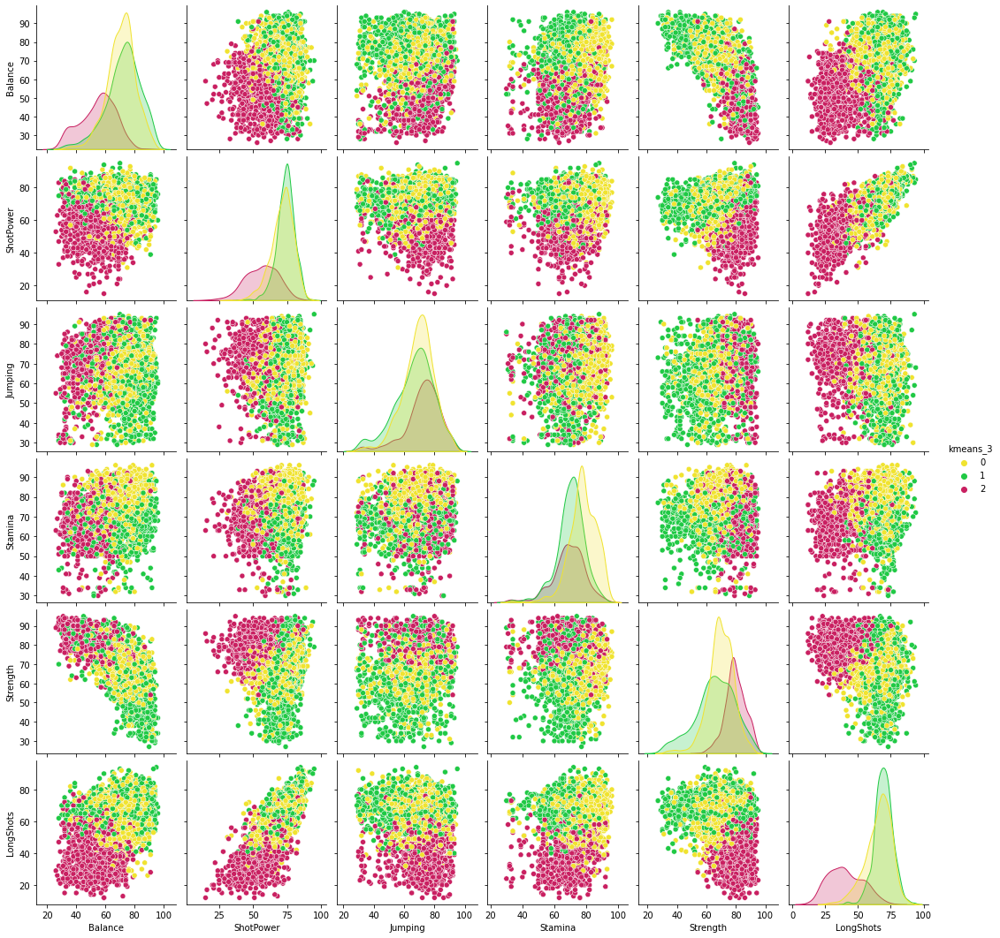

In [15]:
# Si queremos inspeccionar relaciones entre más de dos features podemos usar la clase pairplot de Seaborn
fig = plt.figure()
data = df_clusters[['Balance', 'ShotPower', 'Jumping', 'Stamina', 'Strength', 'LongShots','kmeans_3']]
sns.pairplot(data,
             hue = 'kmeans_3',
             palette={0:'#f0e330', #yellow
                      1:'#20c945', #green
                      2:'#c92061'} #pink 
             )
plt.show()

`Aggression`, `Interceptions`, `Positioning`, `Vision`, `Penalties`

<Figure size 432x288 with 0 Axes>

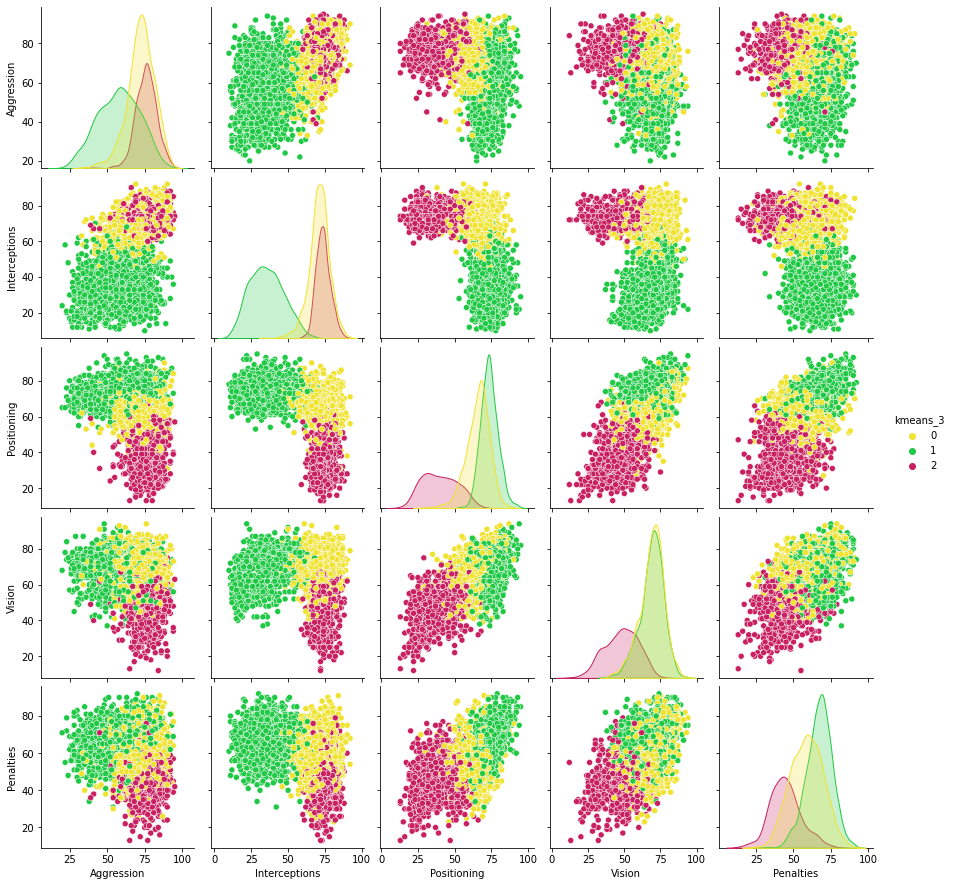

In [16]:
# Si queremos inspeccionar relaciones entre más de dos features podemos usar la clase pairplot de Seaborn
fig = plt.figure()
data = df_clusters[['Aggression', 'Interceptions', 'Positioning', 'Vision', 'Penalties','kmeans_3']]
sns.pairplot(data,
             hue = 'kmeans_3',
             palette={0:'#f0e330', #yellow
                      1:'#20c945', #green
                      2:'#c92061'} #pink 
             )
plt.show()

`Composure`, `Marking`, `StandingTackle`, `SlidingTackle`

<Figure size 432x288 with 0 Axes>

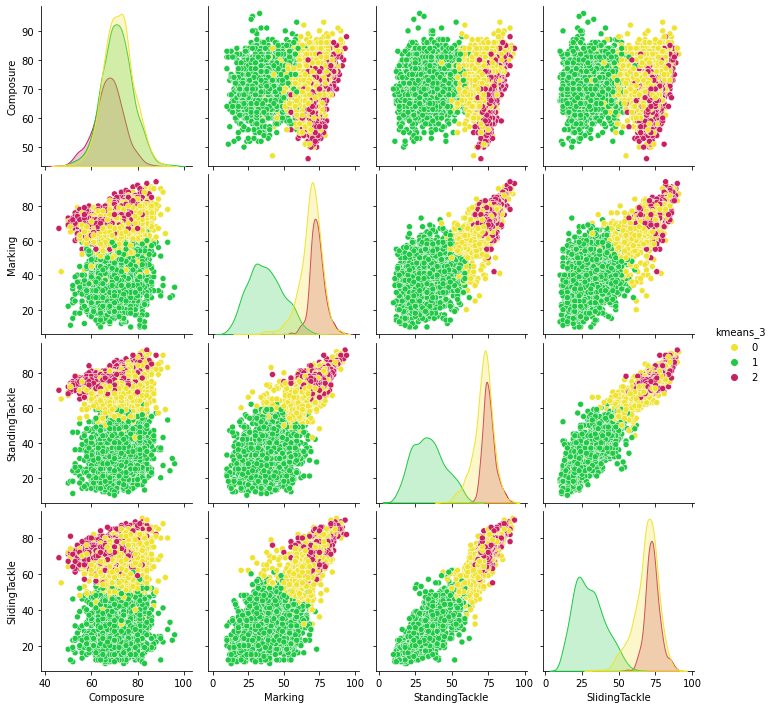

In [17]:
# Si queremos inspeccionar relaciones entre más de dos features podemos usar la clase pairplot de Seaborn
fig = plt.figure()
data = df_clusters[['Composure', 'Marking', 'StandingTackle', 'SlidingTackle','kmeans_3']]
sns.pairplot(data,
             hue = 'kmeans_3',
             palette={0:'#f0e330', #yellow
                      1:'#20c945', #green
                      2:'#c92061'} #pink 
             )
plt.show()

`GKDiving`, `GKHandling`, `GKKicking`, `GKPositioning`, `GKReflexes`

<Figure size 432x288 with 0 Axes>

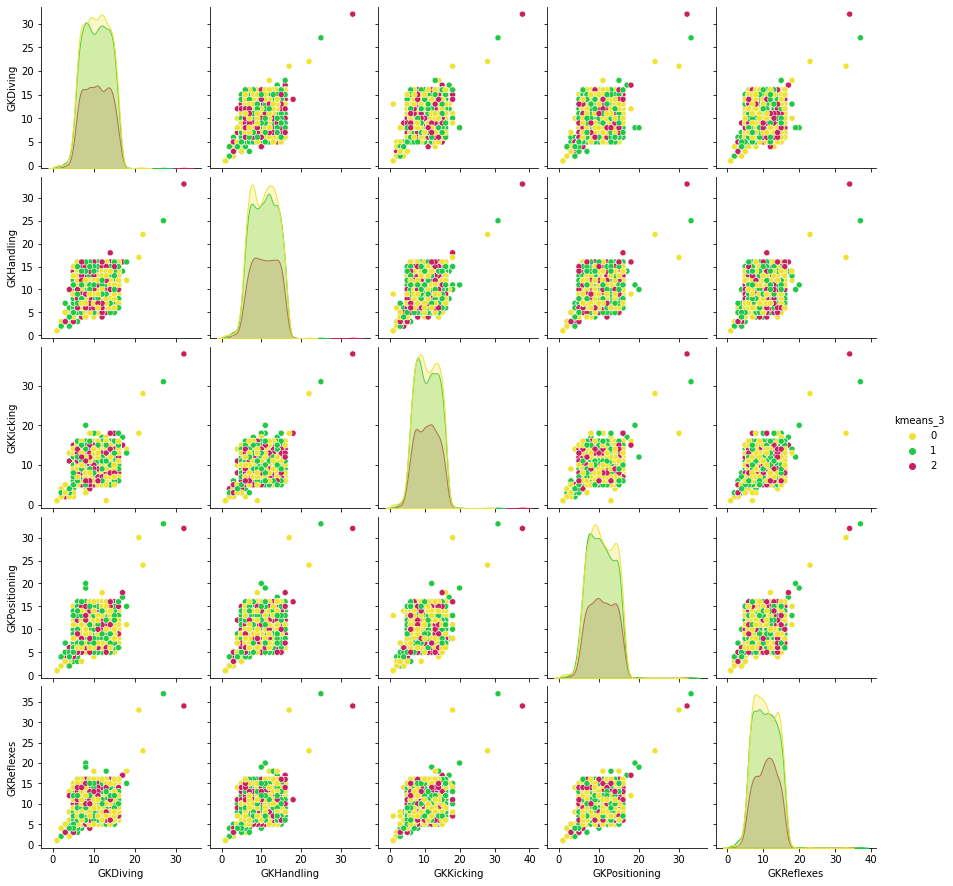

In [18]:
# Si queremos inspeccionar relaciones entre más de dos features podemos usar la clase pairplot de Seaborn
fig = plt.figure()
data = df_clusters[['GKDiving', 'GKHandling', 'GKKicking', 'GKPositioning', 'GKReflexes','kmeans_3']]
sns.pairplot(data,
             hue = 'kmeans_3',
             palette={0:'#f0e330', #yellow
                      1:'#20c945', #green
                      2:'#c92061'} #pink 
             )
plt.show()

Notar que estas ultimas features no las usamos para hacer la clasificacion, porque son habilidades más propias de los arqueros.
Como resultados vemos claramente que los clusteres nos se separan en ninguna de estas features.